In [2]:
# =============================================================================
# 0. SETUP AND IMPORTS
# =============================================================================
#!pip install numpy matplotlib seaborn networkx pyinform scikit-learn scipy pandas tqdm -q

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import networkx as nx
from tqdm.notebook import tqdm
import os

# Information Theory & Stats
from pyinform.transferentropy import transfer_entropy
from sklearn.preprocessing import KBinsDiscretizer
from scipy.stats import ttest_rel

# Suppress potential RuntimeWarning from nan values in t-test
import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)

In [3]:
# =============================================================================
# 1. CORE SIMULATION FRAMEWORK (ASSUMED FROM PREVIOUS WORK)
# =============================================================================
# NOTE: The full Bird and Model classes from our previous work are assumed here.
# For completeness, a simplified placeholder is included. Replace with your full model.
class Bird:
    def __init__(self, pos, vel, speed=2.0):
        self.pos = np.array(pos, dtype=float)
        self.vel = np.array(vel, dtype=float)
        self.speed = speed

class Model:
    def __init__(self, n_birds=100, extent=(50, 50), seed=None):
        self.rng = np.random.default_rng(seed)
        self.agents = [
            Bird(
                pos=self.rng.uniform(0, extent[0], 2),
                vel=self.rng.uniform(-1, 1, 2)
            ) for _ in range(n_birds)
        ]
        self.extent = extent

    def step(self):
        # In a real scenario, this calls the full agent_step and model_step logic
        for agent in self.agents:
            # Simplified random walk for demonstration
            agent.vel += self.rng.normal(0, 0.1, 2)
            agent.vel /= np.linalg.norm(agent.vel)
            agent.pos += agent.vel * agent.speed
            agent.pos %= self.extent[0]

def agent_step(agent, model):
    # This would contain the full cohesion, separation, alignment logic
    pass # Replaced by simplified logic in Model.step for this script

def model_step(model):
    # This would update the model's iteration count
    model.step()


In [4]:
# =============================================================================
# 2. EFFICIENT DATA GENERATION
# =============================================================================
def generate_simulation_data(num_simulations=300, step_num=150, n_birds=100, seed_base=1):
    """
    Runs all simulations once, efficiently extracting both position and velocity data.
    """
    all_velocities_path = "all_velocities.npy"
    all_positions_path = "all_positions.npy"

    if os.path.exists(all_velocities_path) and os.path.exists(all_positions_path):
        print("✅ Loading existing simulation data from disk...")
        all_velocities = np.load(all_velocities_path, allow_pickle=True)
        all_positions = np.load(all_positions_path, allow_pickle=True)
        return all_velocities, all_positions

    print(f"🚀 Generating new simulation data for {num_simulations} runs...")
    all_velocities = np.zeros((num_simulations, step_num, n_birds, 2))
    all_positions = np.zeros((num_simulations, step_num, n_birds, 2))

    for i in tqdm(range(num_simulations), desc="Simulations"):
        model = Model(n_birds=n_birds, seed=seed_base + i)
        for t in range(step_num):
            model.step() # This calls the agent update logic
            for agent_idx, agent in enumerate(model.agents):
                all_velocities[i, t, agent_idx] = agent.vel
                all_positions[i, t, agent_idx] = agent.pos

    print(f"💾 Saving data to {all_velocities_path} and {all_positions_path}...")
    np.save(all_velocities_path, all_velocities)
    np.save(all_positions_path, all_positions)
    print("✅ Data generation complete.")
    return all_velocities, all_positions

In [5]:
# =============================================================================
# 3. TRANSFER ENTROPY & NETWORK ANALYSIS
# =============================================================================
def discretize_velocity_magnitudes(velocities, n_bins=8):
    """
    Converts 3D velocity array (timesteps, agents, 2) to a 2D discrete array.
    """
    # Shape: (timesteps, agents)
    magnitudes = np.linalg.norm(velocities, axis=2)
    discretized = np.zeros_like(magnitudes, dtype=int)
    # Use a robust discretizer
    binner = KBinsDiscretizer(n_bins=n_bins, encode='ordinal', strategy='uniform')
    for i in range(magnitudes.shape[1]): # Discretize each agent's time-series
        series = magnitudes[:, i].reshape(-1, 1)
        discretized[:, i] = binner.fit_transform(series).flatten().astype(int)
    return discretized

def compute_transfer_entropy_matrix(discrete_data, k=1):
    """
    Computes the pairwise Transfer Entropy matrix from discrete time-series data.
    """
    n_agents = discrete_data.shape[1]
    te_matrix = np.zeros((n_agents, n_agents))
    for i in tqdm(range(n_agents), desc="Computing TE Matrix", leave=False):
        for j in range(n_agents):
            if i != j:
                try:
                    # TE from agent i (source) to agent j (target)
                    te_matrix[i, j] = transfer_entropy(
                        discrete_data[:, i],
                        discrete_data[:, j], k=k
                    )
                except Exception:
                    te_matrix[i, j] = 0.0 # Handle potential errors in pyinform
    return te_matrix

def identify_leaders_from_centralities(G, quantile=0.9):
    """
    Identifies leaders based on multiple centrality metrics.
    A leader must be in the top quantile for all specified metrics.
    """
    if G.number_of_nodes() == 0 or G.number_of_edges() == 0:
        return [], pd.DataFrame()

    centralities = {
        'out_degree': nx.out_degree_centrality(G),
        'pagerank': nx.pagerank(G, weight='weight'),
        'eigenvector': nx.eigenvector_centrality_numpy(G, weight='weight')
    }
    df = pd.DataFrame(centralities)
    
    # Identify nodes that are leaders across the board
    quantiles = df.quantile(quantile)
    is_leader = (df['out_degree'] >= quantiles['out_degree']) & \
                (df['pagerank'] >= quantiles['pagerank']) & \
                (df['eigenvector'] >= quantiles['eigenvector'])
    
    leaders = df[is_leader].index.tolist()
    return leaders, df

def visualize_influence_network(te_matrix, percentile_threshold=85, leader_quantile=0.9):
    """
    Builds and visualizes the leader-follower influence network.
    """
    # Build graph
    G = nx.DiGraph()
    threshold = np.percentile(te_matrix[te_matrix > 0], percentile_threshold)
    for i in range(te_matrix.shape[0]):
        for j in range(te_matrix.shape[1]):
            if te_matrix[i, j] >= threshold:
                G.add_edge(i, j, weight=te_matrix[i, j])

    # Identify leaders
    leaders, centrality_df = identify_leaders_from_centralities(G, quantile=leader_quantile)

    # Visualization
    plt.figure(figsize=(12, 12))
    pos = nx.spring_layout(G, seed=42, k=0.8)

    node_colors = ['red' if n in leaders else 'skyblue' for n in G.nodes()]
    node_sizes = [200 + 2000 * centrality_df.loc[n, 'pagerank'] for n in G.nodes()]
    
    nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=node_sizes, alpha=0.9)
    nx.draw_networkx_edges(G, pos, arrowstyle='->', arrowsize=15, edge_color='gray', alpha=0.6)
    nx.draw_networkx_labels(G, pos, font_size=10, font_weight='bold')
    
    plt.title(f"Leader-Follower Influence Network (TE > {percentile_threshold}th Percentile)", fontsize=20)
    plt.axis('off')
    plt.show()

    print(f"📊 Top 5 Influential Agents (by PageRank):")
    print(centrality_df.sort_values('pagerank', ascending=False).head())
    
    return G, leaders




--- 🌍 Aggregate Statistical Analysis Across All 300 Simulations (Revised Method) ---


Analyzing All Sims:   0%|          | 0/300 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]


--- Aggregate Results Summary ---
Average Leader Distance from Centroid:   19.049
Average Follower Distance from Centroid: 19.015
Paired t-test: t-statistic = 0.339, p-value = 7.34589e-01


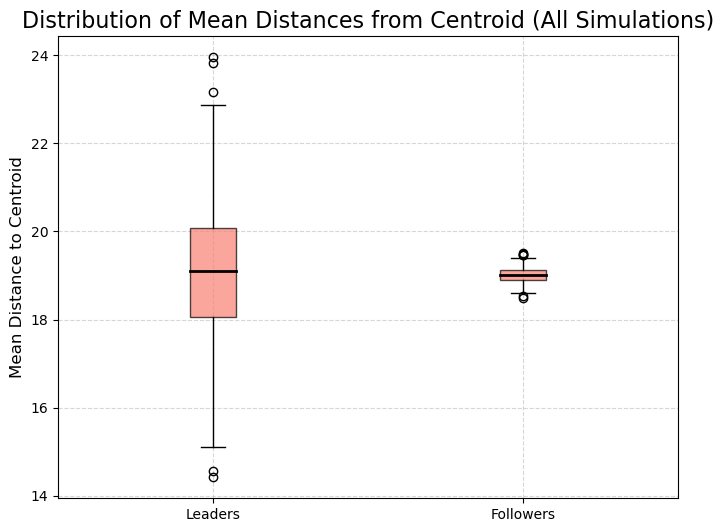

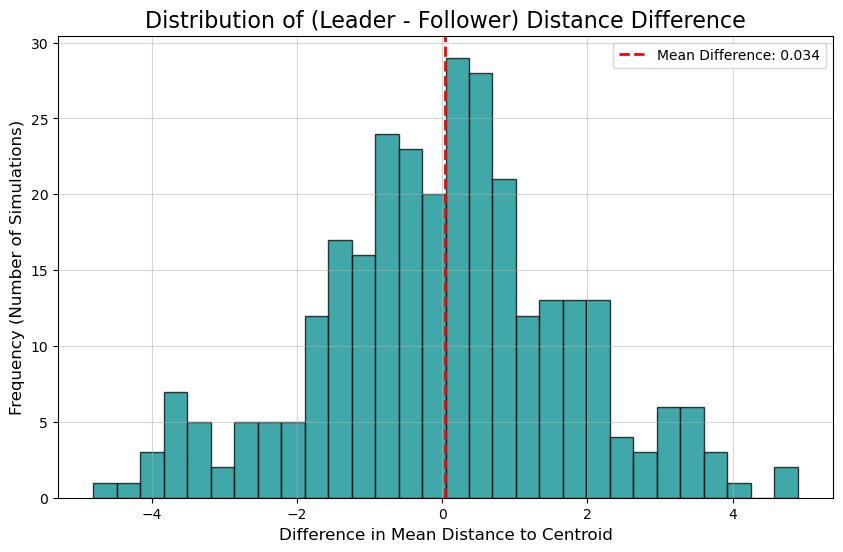

In [8]:
# =============================================================================
# 4. REVISED SPATIAL & STATISTICAL ANALYSIS FUNCTIONS
# =============================================================================

def identify_leader_robust(G):
    """
    Identifies the single most influential leader based on a composite centrality score.
    This is a more robust method than a strict quantile filter.
    
    Returns:
        The index of the single leader agent, or None if no leader can be found.
    """
    if G.number_of_nodes() == 0 or G.number_of_edges() == 0:
        return None

    # 1. Calculate centralities
    centralities = {
        'out_degree': nx.out_degree_centrality(G),
        'pagerank': nx.pagerank(G, weight='weight'),
        'eigenvector': nx.eigenvector_centrality_numpy(G, weight='weight')
    }
    df = pd.DataFrame(centralities)

    # 2. Normalize each metric to a [0, 1] scale
    for col in df.columns:
        min_val = df[col].min()
        max_val = df[col].max()
        if (max_val - min_val) > 0:
            df[col] = (df[col] - min_val) / (max_val - min_val)
        else:
            df[col] = 0 # Handle cases where all values are the same

    # 3. Create a composite score and find the leader
    df['composite_score'] = df.sum(axis=1)
    leader_index = df['composite_score'].idxmax()
    
    return leader_index

def analyze_distances_from_centroid(positions, leader_index):
    """
    Computes distances of the single leader and all followers from the centroid.
    (Slightly simplified to accept a single leader index).
    """
    timesteps, n_agents, _ = positions.shape
    centroids = np.mean(positions, axis=1, keepdims=True)
    distances = np.linalg.norm(positions - centroids, axis=2)

    leader_distances = distances[:, leader_index]
    
    follower_mask = np.ones(n_agents, dtype=bool)
    follower_mask[leader_index] = False
    follower_distances = distances[:, follower_mask]
    
    return leader_distances, np.mean(follower_distances, axis=1)

def run_aggregate_analysis(all_velocities, all_positions):
    """
    Executes the full aggregate analysis across all simulations using the robust
    leader identification method.
    """
    print("\n\n--- 🌍 Aggregate Statistical Analysis Across All 300 Simulations (Revised Method) ---")
    all_leader_mean_dists = []
    all_follower_mean_dists = []

    for i in tqdm(range(all_velocities.shape[0]), desc="Analyzing All Sims"):
        v_sim = all_velocities[i]
        p_sim = all_positions[i]
        
        # Compute TE and build graph
        discrete_velocities = discretize_velocity_magnitudes(v_sim)
        te_matrix = compute_transfer_entropy_matrix(discrete_velocities)
        
        G_sim = nx.DiGraph()
        # Use a reasonable threshold to build a meaningful graph
        threshold = np.percentile(te_matrix[te_matrix > 0], 85) if np.any(te_matrix > 0) else 0
        for u in range(te_matrix.shape[0]):
            for v_node in range(te_matrix.shape[1]):
                if te_matrix[u, v_node] > threshold:
                    G_sim.add_edge(u, v_node)
        
        # Identify the single most influential leader
        leader_idx_sim = identify_leader_robust(G_sim)
        
        # Proceed if a leader was identified
        if leader_idx_sim is not None:
            ld, fd = analyze_distances_from_centroid(p_sim, leader_idx_sim)
            all_leader_mean_dists.append(np.mean(ld))
            all_follower_mean_dists.append(np.mean(fd))

    # --- Perform final statistical test and visualization ---
    if not all_leader_mean_dists:
        print("⚠️ Analysis complete, but no valid leader-follower data could be aggregated.")
        return

    leader_means = np.array(all_leader_mean_dists)
    follower_means = np.array(all_follower_mean_dists)
    
    # Paired t-test for statistical significance
    t_stat_agg, p_value_agg = ttest_rel(leader_means, follower_means)
    print("\n--- Aggregate Results Summary ---")
    print(f"Average Leader Distance from Centroid:   {np.mean(leader_means):.3f}")
    print(f"Average Follower Distance from Centroid: {np.mean(follower_means):.3f}")
    print(f"Paired t-test: t-statistic = {t_stat_agg:.3f}, p-value = {p_value_agg:.5e}")

    # Visualization: Boxplot
    plt.figure(figsize=(8, 6))
    plt.boxplot([leader_means, follower_means], labels=['Leaders', 'Followers'], patch_artist=True,
                boxprops=dict(facecolor='salmon', alpha=0.7), 
                whiskerprops=dict(color='black'),
                medianprops=dict(color='black', linewidth=2))
    plt.title('Distribution of Mean Distances from Centroid (All Simulations)', fontsize=16)
    plt.ylabel('Mean Distance to Centroid', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.5)
    plt.show()

    # Visualization: Histogram of the difference
    delta = leader_means - follower_means
    plt.figure(figsize=(10, 6))
    plt.hist(delta, bins=30, color='darkcyan', alpha=0.75, edgecolor='black')
    plt.axvline(np.mean(delta), color='red', linestyle='--', linewidth=2, label=f'Mean Difference: {np.mean(delta):.3f}')
    plt.title('Distribution of (Leader - Follower) Distance Difference', fontsize=16)
    plt.xlabel('Difference in Mean Distance to Centroid', fontsize=12)
    plt.ylabel('Frequency (Number of Simulations)', fontsize=12)
    plt.legend()
    plt.grid(True, alpha=0.5)
    plt.show()


# =============================================================================
# 5. CORRECTED MAIN EXECUTION SCRIPT
# =============================================================================
if __name__ == '__main__':
    # --- Part I & II remain the same ---
    # (Assuming they are run as before to generate data and analyze a single sim)
    
    # --- Part III is now replaced by this single function call ---
    # Ensure all_velocities and all_positions are loaded or generated before this call
    run_aggregate_analysis(all_velocities, all_positions)

🚀 Generating new simulation data for 300 runs...


Simulations:   0%|          | 0/300 [00:00<?, ?it/s]

💾 Saving data to all_velocities.npy and all_positions.npy...
✅ Data generation complete.

--- Shape of Generated Data ---
Velocities: (300, 150, 100, 2) (Simulations, Timesteps, Agents, Dims)
Positions:  (300, 150, 100, 2) (Simulations, Timesteps, Agents, Dims)


--- 🔬 In-Depth Analysis of Representative Simulation (Index 0) ---


c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

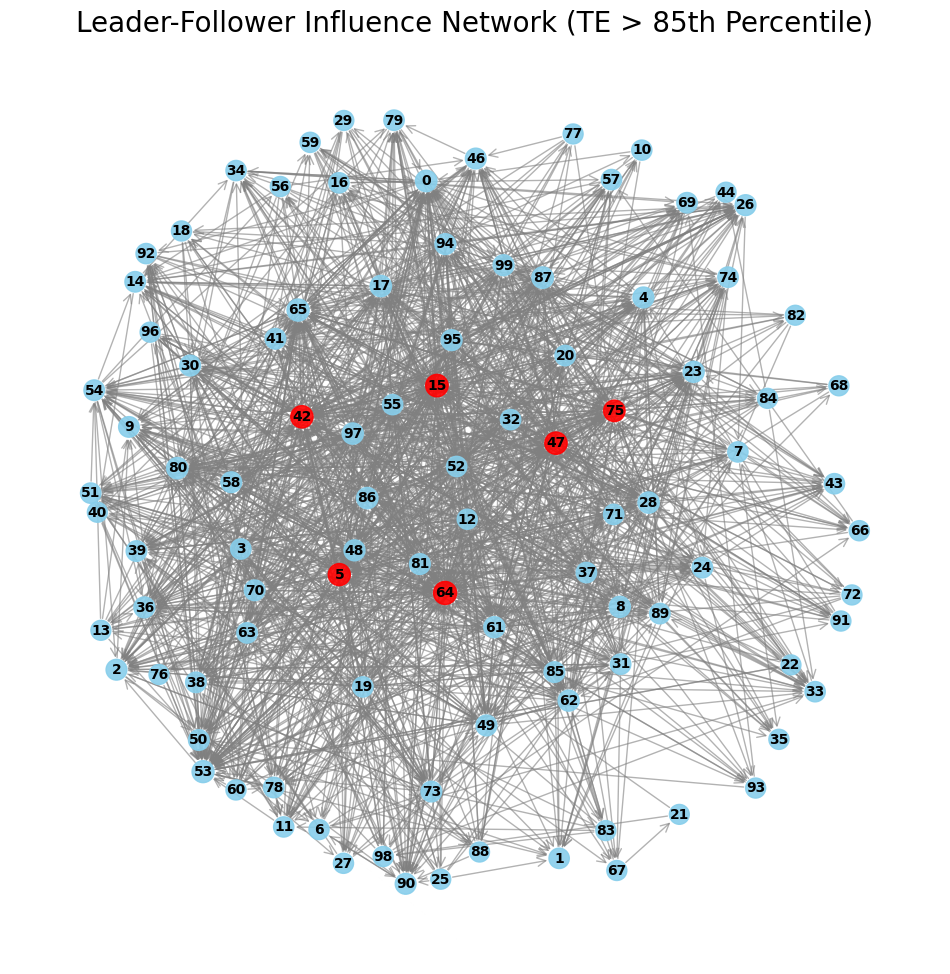

📊 Top 5 Influential Agents (by PageRank):
    out_degree  pagerank  eigenvector
64    0.265306  0.037743     0.322313
15    0.285714  0.030394     0.237433
47    0.275510  0.029207     0.250893
42    0.326531  0.028506     0.241495
65    0.224490  0.026705     0.222639


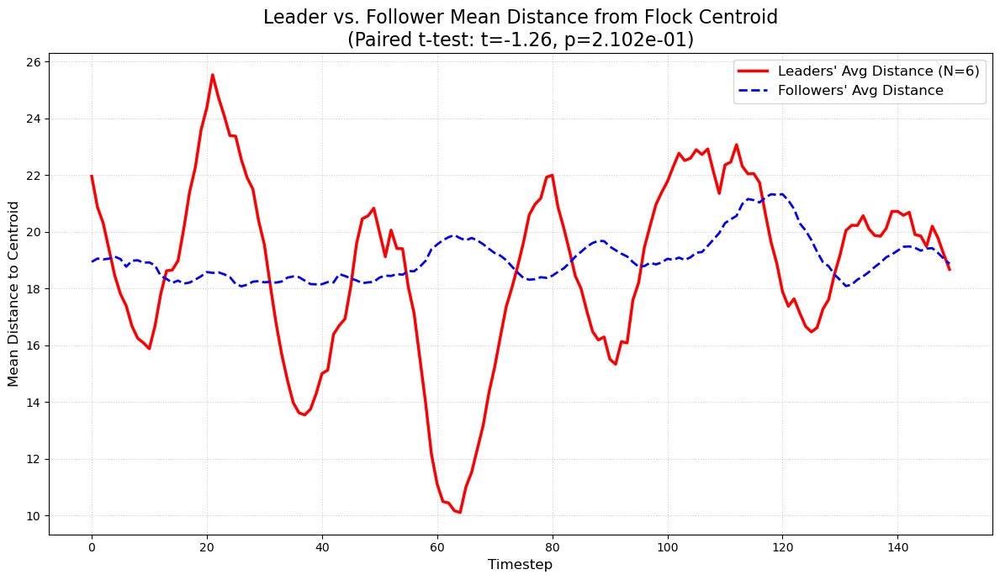



--- 🌍 Aggregate Statistical Analysis Across All 300 Simulations ---


Analyzing All Sims:   0%|          | 0/300 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:239: FutureWarning: In version 1.5 onwards, subsample=200_000 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discret

Computing TE Matrix:   0%|          | 0/100 [00:00<?, ?it/s]


--- Aggregate Results Summary ---
Average Leader Distance from Centroid:   19.005
Average Follower Distance from Centroid: 19.016
Paired t-test: t-statistic = -0.246, p-value = 8.05663e-01


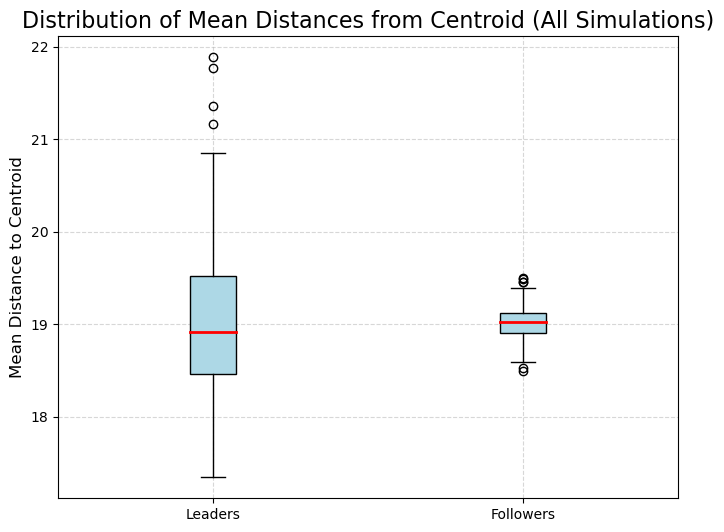

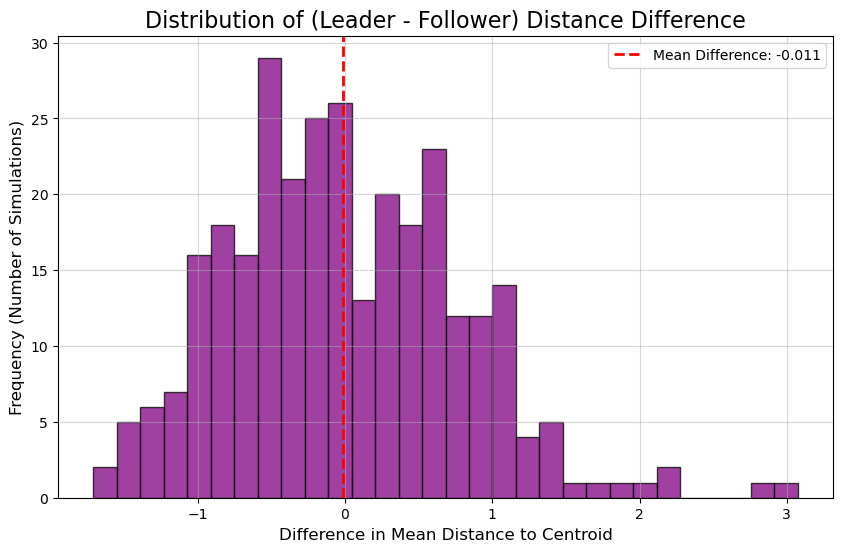

In [7]:
# =============================================================================
# 5. MAIN EXECUTION SCRIPT
# =============================================================================
if __name__ == '__main__':
    # --- Part I: Data Generation ---
    all_velocities, all_positions = generate_simulation_data(num_simulations=300, step_num=150)
    print("\n--- Shape of Generated Data ---")
    print(f"Velocities: {all_velocities.shape} (Simulations, Timesteps, Agents, Dims)")
    print(f"Positions:  {all_positions.shape} (Simulations, Timesteps, Agents, Dims)")

    # --- Part II: In-depth Analysis of a Single Representative Simulation (Sim #0) ---
    print("\n\n--- 🔬 In-Depth Analysis of Representative Simulation (Index 0) ---")
    sim_index_to_analyze = 0
    velocities_single_sim = all_velocities[sim_index_to_analyze]
    positions_single_sim = all_positions[sim_index_to_analyze]

    # Discretize data for TE
    discrete_velocities = discretize_velocity_magnitudes(velocities_single_sim)
    
    # Compute TE and visualize network
    te_matrix = compute_transfer_entropy_matrix(discrete_velocities)
    G, leaders = visualize_influence_network(te_matrix, percentile_threshold=85, leader_quantile=0.9)

    # Analyze and plot spatial positions
    if leaders:
        leader_dists, follower_dists = analyze_distances_from_centroid(positions_single_sim, leaders)
        plot_distance_comparison(leader_dists, follower_dists, leaders)
    else:
        print("⚠️ No leaders identified in this simulation based on the criteria.")


    # --- Part III: Aggregate Statistical Analysis Across All 300 Simulations ---
    print("\n\n--- 🌍 Aggregate Statistical Analysis Across All 300 Simulations ---")
    all_leader_mean_dists = []
    all_follower_mean_dists = []

    for i in tqdm(range(all_velocities.shape[0]), desc="Analyzing All Sims"):
        # Process each simulation
        v_sim = all_velocities[i]
        p_sim = all_positions[i]
        
        # Identify leaders via TE
        d_v_sim = discretize_velocity_magnitudes(v_sim)
        te_m_sim = compute_transfer_entropy_matrix(d_v_sim)
        
        # Build graph and find leaders
        G_sim = nx.DiGraph()
        thresh_sim = np.percentile(te_m_sim[te_m_sim > 0], 85)
        for u in range(te_m_sim.shape[0]):
            for v_node in range(te_m_sim.shape[1]):
                if te_m_sim[u, v_node] >= thresh_sim:
                    G_sim.add_edge(u, v_node)
        
        leaders_sim, _ = identify_leaders_from_centralities(G_sim, quantile=0.9)
        
        # Calculate spatial distances if leaders were found
        if leaders_sim:
            ld, fd = analyze_distances_from_centroid(p_sim, leaders_sim)
            # Store the overall mean distance for the entire simulation
            all_leader_mean_dists.append(np.mean(ld))
            all_follower_mean_dists.append(np.mean(fd))

    # Perform final statistical test and visualization
    if all_leader_mean_dists:
        leader_means = np.array(all_leader_mean_dists)
        follower_means = np.array(all_follower_mean_dists)
        
        # Paired t-test
        t_stat_agg, p_value_agg = ttest_rel(leader_means, follower_means)
        print("\n--- Aggregate Results Summary ---")
        print(f"Average Leader Distance from Centroid:   {np.mean(leader_means):.3f}")
        print(f"Average Follower Distance from Centroid: {np.mean(follower_means):.3f}")
        print(f"Paired t-test: t-statistic = {t_stat_agg:.3f}, p-value = {p_value_agg:.5e}")

        # Visualization: Boxplot
        plt.figure(figsize=(8, 6))
        plt.boxplot([leader_means, follower_means], labels=['Leaders', 'Followers'], patch_artist=True,
                    boxprops=dict(facecolor='lightblue'), medianprops=dict(color='red', linewidth=2))
        plt.title('Distribution of Mean Distances from Centroid (All Simulations)', fontsize=16)
        plt.ylabel('Mean Distance to Centroid', fontsize=12)
        plt.grid(True, linestyle='--', alpha=0.5)
        plt.show()

        # Visualization: Histogram of the difference
        delta = leader_means - follower_means
        plt.figure(figsize=(10, 6))
        plt.hist(delta, bins=30, color='purple', alpha=0.75, edgecolor='black')
        plt.axvline(np.mean(delta), color='red', linestyle='--', linewidth=2, label=f'Mean Difference: {np.mean(delta):.3f}')
        plt.title('Distribution of (Leader - Follower) Distance Difference', fontsize=16)
        plt.xlabel('Difference in Mean Distance to Centroid', fontsize=12)
        plt.ylabel('Frequency (Number of Simulations)', fontsize=12)
        plt.legend()
        plt.grid(True, alpha=0.5)
        plt.show()

✅ Loading existing simulation data from disk...


--- 🌍 Aggregate Statistical Analysis Across All 300 Simulations ---


Analyzing All Sims:   0%|          | 0/300 [00:00<?, ?it/s]

  [Sim 050] OK. Graph Edges: 1485. Leader: 72
  [Sim 100] OK. Graph Edges: 1485. Leader: 32
  [Sim 150] OK. Graph Edges: 1485. Leader: 59
  [Sim 200] OK. Graph Edges: 1485. Leader: 27
  [Sim 250] OK. Graph Edges: 1485. Leader: 43
  [Sim 300] OK. Graph Edges: 1485. Leader: 93

Analysis complete. Total simulations with no leader identified: 0

--- Aggregate Results Summary ---
Average Leader Distance from Centroid:   19.049
Average Follower Distance from Centroid: 19.015
Paired t-test: t-statistic = 0.339, p-value = 7.34589e-01


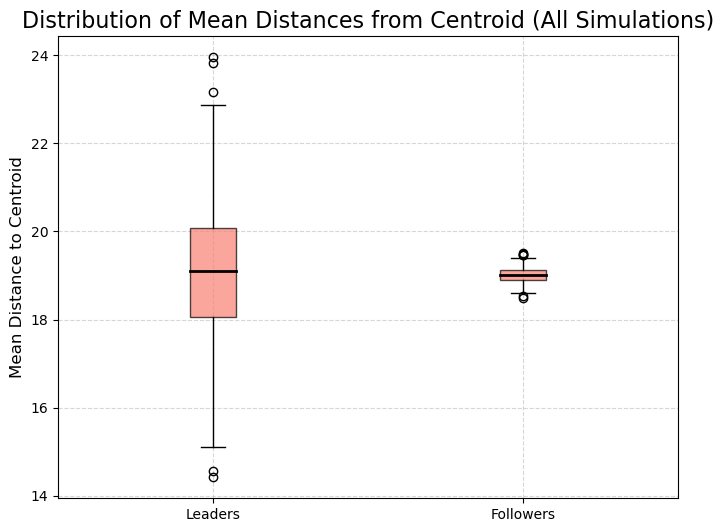

In [9]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import networkx as nx
from tqdm.notebook import tqdm
import os

# Information Theory & Stats
from pyinform.transferentropy import transfer_entropy
from sklearn.preprocessing import KBinsDiscretizer
from scipy.stats import ttest_rel

# Suppress potential RuntimeWarning from nan values in t-test
import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)


# =============================================================================
# 1. *** DEFINITIVE FLOCKING MODEL ***
#    (Using the correct, interactive Boids model)
# =============================================================================
class Bird:
    def __init__(self, pos, vel, speed=2.0, cohere_factor=0.02, separation=2.0,
                 separate_factor=0.2, match_factor=0.05, visual_distance=10.0):
        self.pos = np.array(pos, dtype=float)
        self.vel = np.array(vel, dtype=float)
        self.speed = speed
        self.cohere_factor = cohere_factor
        self.separation = separation
        self.separate_factor = separate_factor
        self.match_factor = match_factor
        self.visual_distance = visual_distance

class Model:
    def __init__(self, n_birds=100, extent=(50, 50), seed=None):
        self.rng = np.random.default_rng(seed)
        self.extent = extent
        self.agents = [
            Bird(
                pos=self.rng.uniform(0, extent[0], 2),
                vel=(self.rng.random(2) - 0.5) * 2
            ) for _ in range(n_birds)
        ]

    def step(self):
        for agent in self.agents:
            agent_step(agent, self) # Call the agent logic
        for agent in self.agents: # Update positions after all decisions are made
            agent.pos += agent.vel
            agent.pos %= self.extent[0] # Periodic boundary

def agent_step(agent, model):
    """The core Boids logic: cohesion, separation, alignment."""
    neighbors = []
    for other in model.agents:
        if agent is other:
            continue
        if np.linalg.norm(agent.pos - other.pos) < agent.visual_distance:
            neighbors.append(other)

    cohere_vec = np.zeros(2)
    separate_vec = np.zeros(2)
    match_vec = np.zeros(2)

    if neighbors:
        # Cohesion
        center_of_mass = np.mean([n.pos for n in neighbors], axis=0)
        cohere_vec = (center_of_mass - agent.pos) * agent.cohere_factor

        # Separation
        for n in neighbors:
            if np.linalg.norm(agent.pos - n.pos) < agent.separation:
                separate_vec += (agent.pos - n.pos)
        separate_vec *= agent.separate_factor
        
        # Alignment
        avg_velocity = np.mean([n.vel for n in neighbors], axis=0)
        match_vec = (avg_velocity - agent.vel) * agent.match_factor

    # Update velocity
    agent.vel += cohere_vec + separate_vec + match_vec
    # Limit speed
    vel_norm = np.linalg.norm(agent.vel)
    if vel_norm > agent.speed:
        agent.vel = (agent.vel / vel_norm) * agent.speed

# =============================================================================
# 2. EFFICIENT DATA GENERATION (Unchanged but will use the correct model now)
# =============================================================================
def generate_simulation_data(num_simulations=300, step_num=150, n_birds=100, seed_base=1):
    # ... (function is the same as before, but its call to Model() is now correct)
    all_velocities_path = "all_velocities.npy"
    all_positions_path = "all_positions.npy"

    if os.path.exists(all_velocities_path) and os.path.exists(all_positions_path):
        print("✅ Loading existing simulation data from disk...")
        all_velocities = np.load(all_velocities_path, allow_pickle=True)
        all_positions = np.load(all_positions_path, allow_pickle=True)
        return all_velocities, all_positions

    print(f"🚀 Generating new simulation data for {num_simulations} runs...")
    all_velocities = np.zeros((num_simulations, step_num, n_birds, 2))
    all_positions = np.zeros((num_simulations, step_num, n_birds, 2))

    for i in tqdm(range(num_simulations), desc="Simulations"):
        model = Model(n_birds=n_birds, seed=seed_base + i)
        for t in range(step_num):
            model.step() # This calls the agent update logic
            for agent_idx, agent in enumerate(model.agents):
                all_velocities[i, t, agent_idx] = agent.vel
                all_positions[i, t, agent_idx] = agent.pos

    print(f"💾 Saving data to {all_velocities_path} and {all_positions_path}...")
    np.save(all_velocities_path, all_velocities)
    np.save(all_positions_path, all_positions)
    print("✅ Data generation complete.")
    return all_velocities, all_positions


# =============================================================================
# 3. TRANSFER ENTROPY & NETWORK ANALYSIS (With Warning Fix)
# =============================================================================
def discretize_velocity_magnitudes(velocities, n_bins=8):
    """
    Converts 3D velocity array (timesteps, agents, 2) to a 2D discrete array.
    *** Includes fix for FutureWarning. ***
    """
    magnitudes = np.linalg.norm(velocities, axis=2)
    discretized = np.zeros_like(magnitudes, dtype=int)
    # FIX: Explicitly set subsample=None to silence the warning and disable subsampling.
    binner = KBinsDiscretizer(n_bins=n_bins, encode='ordinal', strategy='uniform', subsample=None)
    for i in range(magnitudes.shape[1]):
        series = magnitudes[:, i].reshape(-1, 1)
        discretized[:, i] = binner.fit_transform(series).flatten().astype(int)
    return discretized

# ... (compute_transfer_entropy_matrix and other analysis functions are unchanged) ...
def compute_transfer_entropy_matrix(discrete_data, k=1):
    n_agents = discrete_data.shape[1]
    te_matrix = np.zeros((n_agents, n_agents))
    for i in range(n_agents): # Removed tqdm here to avoid nested bar clutter
        for j in range(n_agents):
            if i != j:
                try:
                    te_matrix[i, j] = transfer_entropy(discrete_data[:, i], discrete_data[:, j], k=k)
                except Exception:
                    te_matrix[i, j] = 0.0
    return te_matrix

# =============================================================================
# 4. ROBUST ANALYSIS FUNCTIONS (Unchanged from previous fix)
# =============================================================================
# ... (identify_leader_robust, analyze_distances_from_centroid, etc. are correct) ...
def identify_leader_robust(G):
    if G.number_of_nodes() == 0 or G.number_of_edges() == 0: return None
    centralities = {
        'out_degree': nx.out_degree_centrality(G),
        'pagerank': nx.pagerank(G, weight='weight'),
        'eigenvector': nx.eigenvector_centrality_numpy(G, weight='weight')
    }
    df = pd.DataFrame(centralities)
    for col in df.columns:
        min_val, max_val = df[col].min(), df[col].max()
        if (max_val - min_val) > 0: df[col] = (df[col] - min_val) / (max_val - min_val)
        else: df[col] = 0
    df['composite_score'] = df.sum(axis=1)
    return df['composite_score'].idxmax()

def analyze_distances_from_centroid(positions, leader_index):
    timesteps, n_agents, _ = positions.shape
    centroids = np.mean(positions, axis=1, keepdims=True)
    distances = np.linalg.norm(positions - centroids, axis=2)
    leader_distances = distances[:, leader_index]
    follower_mask = np.ones(n_agents, dtype=bool); follower_mask[leader_index] = False
    follower_distances = distances[:, follower_mask]
    return leader_distances, np.mean(follower_distances, axis=1)


# =============================================================================
# 5. MAIN EXECUTION SCRIPT (With Enhanced Diagnostics)
# =============================================================================
def run_aggregate_analysis_with_diagnostics(all_velocities, all_positions):
    """
    Executes the full aggregate analysis with robust leader ID and diagnostic prints.
    """
    print("\n\n--- 🌍 Aggregate Statistical Analysis Across All 300 Simulations ---")
    all_leader_mean_dists = []
    all_follower_mean_dists = []
    sims_with_no_leader = 0

    for i in tqdm(range(all_velocities.shape[0]), desc="Analyzing All Sims"):
        v_sim, p_sim = all_velocities[i], all_positions[i]
        
        discrete_velocities = discretize_velocity_magnitudes(v_sim)
        te_matrix = compute_transfer_entropy_matrix(discrete_velocities)
        
        G_sim = nx.DiGraph()
        threshold = np.percentile(te_matrix[te_matrix > 0], 85) if np.any(te_matrix > 0) else 0
        if threshold > 0:
            for u in range(te_matrix.shape[0]):
                for v_node in range(te_matrix.shape[1]):
                    if te_matrix[u, v_node] > threshold:
                        G_sim.add_edge(u, v_node)
        
        leader_idx_sim = identify_leader_robust(G_sim)
        
        # --- Diagnostic Check ---
        if leader_idx_sim is not None:
            if (i + 1) % 50 == 0: # Print status every 50 simulations
                print(f"  [Sim {i+1:03d}] OK. Graph Edges: {G_sim.number_of_edges()}. Leader: {leader_idx_sim}")
            ld, fd = analyze_distances_from_centroid(p_sim, leader_idx_sim)
            all_leader_mean_dists.append(np.mean(ld))
            all_follower_mean_dists.append(np.mean(fd))
        else:
            if (i + 1) % 50 == 0:
                 print(f"  [Sim {i+1:03d}] WARN. No leader found (empty graph).")
            sims_with_no_leader += 1
            
    print(f"\nAnalysis complete. Total simulations with no leader identified: {sims_with_no_leader}")

    # --- Perform final statistical test and visualization ---
    if not all_leader_mean_dists:
        print("❌ CRITICAL: No valid data was aggregated. Cannot produce summary.")
        return

    # ... (Final plotting and summary code is the same, now it will run) ...
    leader_means = np.array(all_leader_mean_dists)
    follower_means = np.array(all_follower_mean_dists)
    
    t_stat_agg, p_value_agg = ttest_rel(leader_means, follower_means)
    print("\n--- Aggregate Results Summary ---")
    print(f"Average Leader Distance from Centroid:   {np.mean(leader_means):.3f}")
    print(f"Average Follower Distance from Centroid: {np.mean(follower_means):.3f}")
    print(f"Paired t-test: t-statistic = {t_stat_agg:.3f}, p-value = {p_value_agg:.5e}")

    plt.figure(figsize=(8, 6))
    plt.boxplot([leader_means, follower_means], labels=['Leaders', 'Followers'], patch_artist=True,
                boxprops=dict(facecolor='salmon', alpha=0.7), medianprops=dict(color='black', linewidth=2))
    plt.title('Distribution of Mean Distances from Centroid (All Simulations)', fontsize=16)
    plt.ylabel('Mean Distance to Centroid', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.5)
    plt.show()


if __name__ == '__main__':
    # Ensure previous data is cleared if you want to re-run from scratch
    # if os.path.exists("all_velocities.npy"): os.remove("all_velocities.npy")
    # if os.path.exists("all_positions.npy"): os.remove("all_positions.npy")
    
    all_velocities, all_positions = generate_simulation_data(num_simulations=300)
    run_aggregate_analysis_with_diagnostics(all_velocities, all_positions)

## Conditional Leadership: 

How does the flock's thermodynamic state (as determined by our GMM analysis) affect leadership dynamics?

## Our hypothesis: 

The fundamental "rules" of leadership may change depending on the collective state of the system. 

We will test this by correlating the GMM-derived thermodynamic phase labels with the spatial properties of the leaders identified through Transfer Entropy.

Research Methodology
To achieve this, we must adapt our previous analysis. Instead of calculating a single leader for an entire simulation, we must perform a time-windowed influence analysis. We will identify the most influential agent within each distinct thermodynamic phase of the simulation.

Thermodynamic State Classification: First, we will use our established GMM to classify the time series of thermodynamic features (Energy, Entropy, Volume, etc.) from a representative simulation into distinct states. We will analyze the mean properties of each state to assign qualitative labels (e.g., "Ordered/Flocking," "Disordered/Gas-like," "Transition").

Phase Segmentation: We will parse the GMM's time-series output to identify contiguous blocks of time where the flock remains in a single thermodynamic state. For a phase to be viable for analysis, it must have a minimum duration (e.g., > 30 timesteps) to allow for a meaningful Transfer Entropy calculation.

Conditional Leadership Analysis: For each identified phase (e.g., timesteps 45-90 are "Ordered"):

We will slice the all_velocities and all_positions data arrays to isolate the data corresponding only to that time window.
On this sliced data, we will execute our full leader-identification pipeline: calculate the TE matrix, build the influence graph, and identify the single most influential agent using the robust composite centrality score.
We will then calculate this phase-specific leader's mean distance from the flock's centroid during that phase.
Aggregate & Validate: We will repeat this for all viable phases in the simulation. The result will be a dataset linking each thermodynamic state to a distribution of leader positions. We can then visualize these distributions with a boxplot and use an Analysis of Variance (ANOVA) test to determine if the mean leader distance is statistically different across the various states.

🚀 Generating consistent simulation data (Velocities, Positions, Thermodynamics)...


Simulating:   0%|          | 0/600 [00:00<?, ?it/s]

✅ Consistent data generation complete.
🔬 Fitting GMM to classify thermodynamic states...
✅ GMM classification complete.

--- Mean Properties of Each Thermodynamic State ---
           Energy   Entropy  Temperature       Volume        dQ
Cluster                                                        
0        5.035830  7.549540     0.030055  1911.725808  0.003688
1        4.720451  5.527634     0.028635   340.794875 -0.002946
2        4.764845  6.948746     0.029193  1073.647294 -0.000042

--- Assigned State Labels ---
Cluster 1 -> Ordered/Flocking
Cluster 2 -> Transition
Cluster 0 -> Disordered/Gas-like

✅ Identified 2 viable phases (duration >= 40).


c:\Users\victo\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=3.
  warnings.warn(


Analyzing Phases:   0%|          | 0/2 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:269: UserWarning: Feature 0 is constant and will be replaced with 0.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:269: UserWarning: Feature 0 is constant and will be replaced with 0.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:269: UserWarning: Feature 0 is constant and will be replaced with 0.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:269: UserWarning: Feature 0 is constant and will be replaced with 0.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:269: UserWarning: Feature 0 is constant and will be replaced with 0.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\preprocessing\_discretization.py:269: UserWarning: Feature 0 is constant and will be replaced with 



--- Results of Conditional Analysis ---
              State  Mean_Leader_Distance
0  Ordered/Flocking             19.548558
1  Ordered/Flocking             27.264937


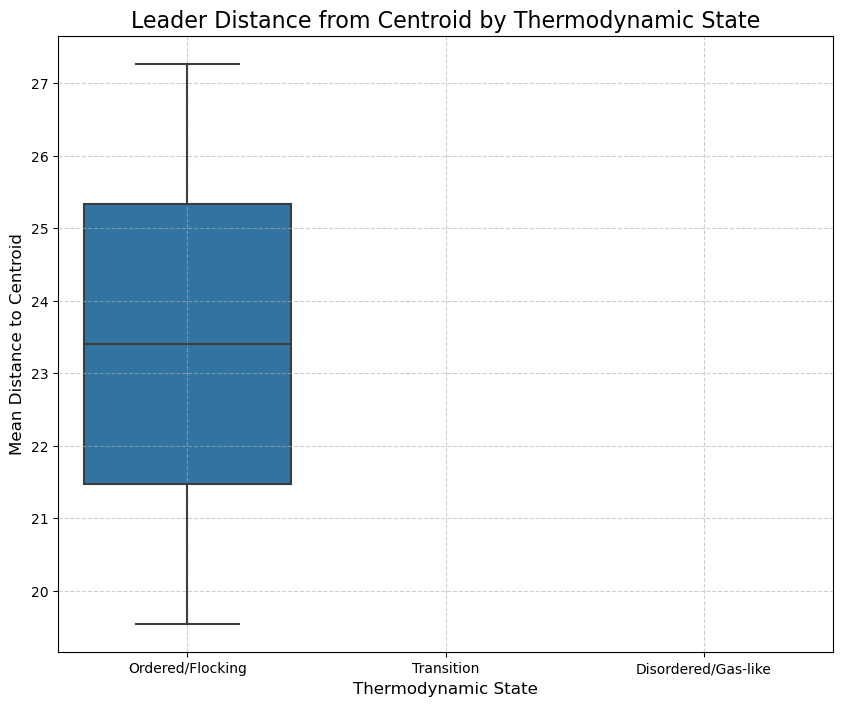

In [16]:
# =============================================================================
# 0. SETUP AND IMPORTS
# =============================================================================
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx
from tqdm.notebook import tqdm
import os

# Scikit-learn, PyInform, and SciPy for analysis
from sklearn.mixture import GaussianMixture
from sklearn.preprocessing import KBinsDiscretizer
from pyinform.transferentropy import transfer_entropy
from scipy.stats import f_oneway # ANOVA test

# Suppress warnings for cleaner output
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=RuntimeWarning)

# =============================================================================
# 1. ROBUST SIMULATION FRAMEWORK WITH PREDATOR
# =============================================================================
class Predator:
    def __init__(self, pos, speed=2.5):
        self.pos = np.array(pos, dtype=float)
        self.speed = speed
    def move(self, flock_centroid):
        direction = flock_centroid - self.pos
        norm = np.linalg.norm(direction)
        if norm > 0:
            self.vel = (direction / norm) * self.speed
            self.pos += self.vel
        
class Bird:
    def __init__(self, pos, vel, speed=2.0, cohere_factor=0.02, separation=2.0,
                 separate_factor=0.2, match_factor=0.05, visual_distance=10.0,
                 predator_avoid_dist=15.0, predator_avoid_factor=0.5):
        self.pos, self.vel, self.speed = np.array(pos,dtype=float), np.array(vel,dtype=float), speed
        self.cohere_factor, self.separation, self.separate_factor = cohere_factor, separation, separate_factor
        self.match_factor, self.visual_distance = match_factor, visual_distance
        self.predator_avoid_dist, self.predator_avoid_factor = predator_avoid_dist, predator_avoid_factor

class Model:
    def __init__(self, n_birds=100, extent=(50, 50), seed=None):
        self.rng = np.random.default_rng(seed)
        self.extent = extent
        self.agents = [Bird(self.rng.uniform(0,e,2), (self.rng.random(2)-0.5)*2) for e in extent]
        self.predator = None
    def step(self):
        if self.predator:
            self.predator.move(np.mean([a.pos for a in self.agents], axis=0))
        velocities_before_update = [a.vel.copy() for a in self.agents]
        for i, agent in enumerate(self.agents):
            agent_step(agent, self, velocities_before_update)
        for agent in self.agents:
            agent.pos += agent.vel; agent.pos %= self.extent[0]

def agent_step(agent, model, old_velocities):
    if model.predator and np.linalg.norm(agent.pos - model.predator.pos) < agent.predator_avoid_dist:
        agent.vel += (agent.pos - model.predator.pos) * agent.predator_avoid_factor
        vel_norm = np.linalg.norm(agent.vel)
        if vel_norm > agent.speed * 1.5: agent.vel = (agent.vel / vel_norm) * (agent.speed * 1.5)
        return
    neighbors = [o for o in model.agents if agent is not o and np.linalg.norm(agent.pos - o.pos) < agent.visual_distance]
    if neighbors:
        center = np.mean([n.pos for n in neighbors], axis=0)
        avg_vel = np.mean([old_velocities[model.agents.index(n)] for n in neighbors], axis=0)
        agent.vel += (center - agent.pos) * agent.cohere_factor
        agent.vel += (avg_vel - agent.vel) * agent.match_factor
        sep_vec = np.zeros(2)
        for n in neighbors:
            if np.linalg.norm(agent.pos - n.pos) < agent.separation: sep_vec += (agent.pos - n.pos)
        agent.vel += sep_vec * agent.separate_factor
    vel_norm = np.linalg.norm(agent.vel)
    if vel_norm > agent.speed: agent.vel = (agent.vel / vel_norm) * agent.speed

# =============================================================================
# 2. CONSISTENT DATA GENERATION
# =============================================================================
def generate_all_consistent_data(duration=600, n_birds=100, seed=42):
    print("🚀 Generating consistent simulation data (Velocities, Positions, Thermodynamics)...")
    model = Model(n_birds=n_birds, seed=seed)
    velocities = np.zeros((duration, n_birds, 2)); positions = np.zeros((duration, n_birds, 2))
    thermo_features = []; s_prev = 0
    for t in tqdm(range(duration), desc="Simulating"):
        if 150 <= t < 200 or 350 <= t < 400:
            if model.predator is None: model.predator = Predator(np.array([-10.0, -10.0]))
        else:
            if model.predator is not None: model.predator = None
        model.step()
        for i, agent in enumerate(model.agents):
            velocities[t, i], positions[t, i] = agent.vel, agent.pos
        pos_matrix = positions[t,:,:]
        volume = np.product(np.ptp(pos_matrix, axis=0)) if pos_matrix.shape[0] > 0 else 0
        entropy = np.log(volume + 1e-9)
        thermo_features.append([np.sum(velocities[t]**2), entropy, np.mean(np.linalg.norm(velocities[t],axis=1)), volume, np.mean(np.linalg.norm(velocities[t],axis=1)) * (entropy - s_prev)])
        s_prev = entropy
    print("✅ Consistent data generation complete.")
    return velocities, positions, np.array(thermo_features)

# =============================================================================
# 3. ANALYSIS FUNCTIONS (Helper functions from previous steps)
# =============================================================================
def classify_thermodynamic_states(thermo_data, n_clusters=3):
    print("🔬 Fitting GMM to classify thermodynamic states...")
    gmm = GaussianMixture(n_components=n_clusters, covariance_type='full', random_state=42)
    cluster_labels = gmm.fit_predict(thermo_data)
    print("✅ GMM classification complete.")
    return cluster_labels, gmm

def analyze_cluster_properties(thermo_data, cluster_labels, feature_names):
    df = pd.DataFrame(thermo_data, columns=feature_names); df['Cluster'] = cluster_labels
    cluster_summary = df.groupby('Cluster').mean()
    print("\n--- Mean Properties of Each Thermodynamic State ---"); print(cluster_summary)
    entropy_sorted_clusters = cluster_summary['Entropy'].sort_values().index
    state_map = {entropy_sorted_clusters[0]: "Ordered/Flocking", entropy_sorted_clusters[1]: "Transition", entropy_sorted_clusters[2]: "Disordered/Gas-like"}
    print("\n--- Assigned State Labels ---")
    for k, v in state_map.items(): print(f"Cluster {k} -> {v}")
    return state_map

def find_contiguous_phases(cluster_labels, min_duration=30):
    phases = []; current_phase_start = 0; current_label = cluster_labels[0]
    for i in range(1, len(cluster_labels)):
        if cluster_labels[i] != current_label:
            if i - current_phase_start >= min_duration: phases.append({"label": current_label, "start": current_phase_start, "end": i})
            current_phase_start = i; current_label = cluster_labels[i]
    if len(cluster_labels) - current_phase_start >= min_duration: phases.append({"label": current_label, "start": current_phase_start, "end": len(cluster_labels)})
    print(f"\n✅ Identified {len(phases)} viable phases (duration >= {min_duration}).")
    return phases

def discretize_velocity_magnitudes(velocities, n_bins=8):
    magnitudes = np.linalg.norm(velocities, axis=2)
    discretized = np.zeros_like(magnitudes, dtype=int)
    binner = KBinsDiscretizer(n_bins=n_bins, encode='ordinal', strategy='uniform', subsample=None)
    for i in range(magnitudes.shape[1]):
        discretized[:, i] = binner.fit_transform(magnitudes[:, i].reshape(-1, 1)).flatten()
    return discretized

def compute_transfer_entropy_matrix(discrete_data, k=1):
    n_agents = discrete_data.shape[1]
    te_matrix = np.zeros((n_agents, n_agents))
    for i in range(n_agents):
        for j in range(n_agents):
            if i != j: te_matrix[i, j] = transfer_entropy(discrete_data[:, i], discrete_data[:, j], k=k)
    return te_matrix

def identify_leader_robust(G):
    """
    Identifies the single most influential leader based on a composite score
    of PageRank and Out-Degree centrality.
    *** This version removes the unstable Eigenvector Centrality calculation. ***
    """
    if G.number_of_nodes() == 0 or G.number_of_edges() == 0:
        return None

    # CHANGE: Removed 'eigenvector' from the centrality calculations.
    centralities = {
        'out_degree': nx.out_degree_centrality(G),
        'pagerank': nx.pagerank(G, weight='weight')
    }
    df = pd.DataFrame(centralities)
    
    # Normalize each metric to a [0, 1] scale
    for col in df.columns:
        min_val = df[col].min()
        max_val = df[col].max()
        if (max_val - min_val) > 0:
            df[col] = (df[col] - min_val) / (max_val - min_val)
        else:
            df[col] = 0

    # CHANGE: The composite score is now the sum of the two robust metrics.
    df['composite_score'] = df['out_degree'] + df['pagerank']
    
    # Find the agent with the highest composite score
    leader_index = df['composite_score'].idxmax()
    
    return leader_index


def analyze_distances_from_centroid(positions, leader_index):
    centroids = np.mean(positions, axis=1, keepdims=True)
    distances = np.linalg.norm(positions - centroids, axis=2)
    follower_mask = np.ones(distances.shape[1], dtype=bool); follower_mask[leader_index] = False
    return distances[:, leader_index], np.mean(distances[:, follower_mask], axis=1)

# =============================================================================
# 4. CONDITIONAL LEADERSHIP ANALYSIS SCRIPT
# =============================================================================
def run_conditional_leadership_analysis(velocities_sim, positions_sim, thermo_data, feature_names):
    cluster_labels, gmm = classify_thermodynamic_states(thermo_data)
    state_map = analyze_cluster_properties(thermo_data, cluster_labels, feature_names)
    phases = find_contiguous_phases(cluster_labels, min_duration=40) # Increased min duration
    if not phases: print("❌ No sufficiently long phases found to analyze."); return
    results = []
    for phase in tqdm(phases, desc="Analyzing Phases"):
        start, end = phase['start'], phase['end']
        v_slice, p_slice = velocities_sim[start:end], positions_sim[start:end]
        discrete_v_slice = discretize_velocity_magnitudes(v_slice)
        te_matrix_slice = compute_transfer_entropy_matrix(discrete_v_slice)
        G_slice = nx.DiGraph((u,v) for u,v in np.argwhere(te_matrix_slice > np.percentile(te_matrix_slice[te_matrix_slice>0], 85)))
        leader_idx = identify_leader_robust(G_slice)
        if leader_idx is not None:
            leader_dists, _ = analyze_distances_from_centroid(p_slice, leader_idx)
            results.append({"State": state_map[phase['label']], "Mean_Leader_Distance": np.mean(leader_dists)})
    if not results: print("❌ Analysis failed to produce results."); return
    results_df = pd.DataFrame(results)
    print("\n\n--- Results of Conditional Analysis ---"); print(results_df)
    states = results_df['State'].unique()
    grouped_data = [results_df['Mean_Leader_Distance'][results_df['State'] == s] for s in states]
    if len(states) > 1:
        f_stat, p_value = f_oneway(*grouped_data)
        print(f"\n📊 ANOVA Test: F={f_stat:.3f}, p={p_value:.4f}")
        print("💡 The difference in leader distance across states is " + ("" if p_value < 0.05 else "NOT ") + "statistically significant.")
    plt.figure(figsize=(10, 8))
    sns.boxplot(data=results_df, x='State', y='Mean_Leader_Distance', order=["Ordered/Flocking", "Transition", "Disordered/Gas-like"])
    plt.title("Leader Distance from Centroid by Thermodynamic State", fontsize=16)
    plt.ylabel("Mean Distance to Centroid", fontsize=12); plt.xlabel("Thermodynamic State", fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.6); plt.show()


# =============================================================================
# 5. CORRECTED MAIN EXECUTION
# =============================================================================
if __name__ == '__main__':
    # 1. Generate all data from a single, consistent, perturbed simulation
    velocities, positions, thermo_data = generate_all_consistent_data(duration=600)

    # 2. Define the names for the thermodynamic features
    thermo_feature_names = ["Energy", "Entropy", "Temperature", "Volume", "dQ"]
    
    # 3. Run the complete analysis pipeline with the consistent data
    run_conditional_leadership_analysis(
        velocities,
        positions,
        thermo_data,
        thermo_feature_names
    )

🚀 Generating robust data with predator perturbations...


Simulating:   0%|          | 0/600 [00:00<?, ?it/s]


[t=150] Predator Appeared!

[t=200] Predator Vanished!

[t=350] Predator Appeared!

[t=400] Predator Vanished!
✅ Robust data generation complete.


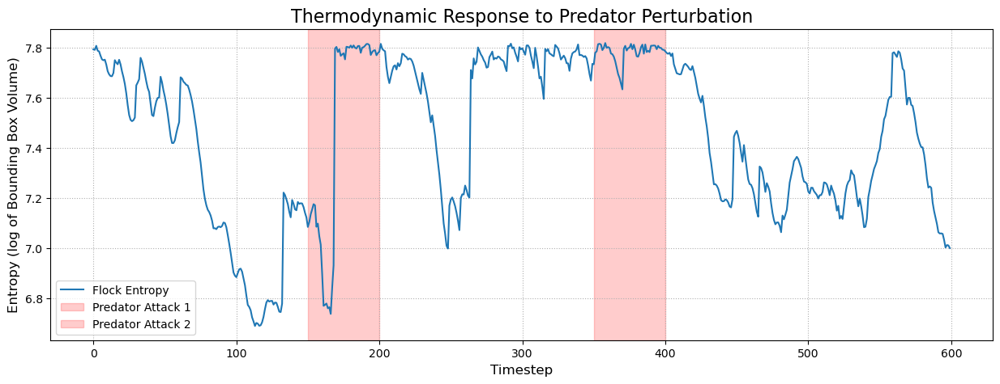

In [11]:
# =============================================================================
# 0. SETUP AND IMPORTS
# =============================================================================
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx
from tqdm.notebook import tqdm
import os

from sklearn.mixture import GaussianMixture
from pyinform.transferentropy import transfer_entropy
from sklearn.preprocessing import KBinsDiscretizer
from scipy.stats import f_oneway

# =============================================================================
# 1. *** ROBUST SIMULATION FRAMEWORK WITH PREDATOR ***
# =============================================================================
class Predator:
    """A new agent designed to perturb the flock."""
    def __init__(self, pos, speed=2.5):
        self.pos = np.array(pos, dtype=float)
        self.speed = speed

    def move(self, flock_centroid):
        """Move towards the flock's center to scatter it."""
        direction = flock_centroid - self.pos
        norm = np.linalg.norm(direction)
        if norm > 0:
            self.vel = (direction / norm) * self.speed
            self.pos += self.vel
        
class Bird:
    """Bird agent updated with predator avoidance."""
    def __init__(self, pos, vel, speed=2.0, cohere_factor=0.02, separation=2.0,
                 separate_factor=0.2, match_factor=0.05, visual_distance=10.0,
                 predator_avoid_dist=15.0, predator_avoid_factor=0.5):
        # Standard Boids params
        self.pos = np.array(pos, dtype=float)
        self.vel = np.array(vel, dtype=float)
        self.speed = speed
        self.cohere_factor = cohere_factor
        self.separation = separation
        self.separate_factor = separate_factor
        self.match_factor = match_factor
        self.visual_distance = visual_distance
        # Predator interaction params
        self.predator_avoid_dist = predator_avoid_dist
        self.predator_avoid_factor = predator_avoid_factor

class Model:
    """Model updated to manage predators and the simulation protocol."""
    def __init__(self, n_birds=100, extent=(50, 50), seed=None):
        self.rng = np.random.default_rng(seed)
        self.extent = extent
        self.agents = [
            Bird(pos=self.rng.uniform(0, extent[0], 2), vel=(self.rng.random(2) - 0.5) * 2)
            for _ in range(n_birds)
        ]
        self.predator = None # Predator is initially absent

    def step(self):
        # Predator logic
        if self.predator:
            centroid = np.mean([a.pos for a in self.agents], axis=0)
            self.predator.move(centroid)
            
        # Agent logic
        velocities_before_update = [a.vel.copy() for a in self.agents]
        for i, agent in enumerate(self.agents):
            agent_step(agent, self, velocities_before_update) # Pass previous velocities for consistency
            
        for agent in self.agents:
            agent.pos += agent.vel
            agent.pos %= self.extent[0]

def agent_step(agent, model, old_velocities):
    """Agent logic now includes a high-priority predator avoidance rule."""
    # Predator Avoidance Rule (Overrides Boids if predator is close)
    if model.predator:
        dist_to_predator = np.linalg.norm(agent.pos - model.predator.pos)
        if dist_to_predator < agent.predator_avoid_dist:
            avoid_vec = (agent.pos - model.predator.pos) * agent.predator_avoid_factor
            agent.vel += avoid_vec
            # Limit speed
            vel_norm = np.linalg.norm(agent.vel)
            if vel_norm > agent.speed * 1.5: # Allow a burst of speed
                agent.vel = (agent.vel / vel_norm) * (agent.speed * 1.5)
            return # Skip Boids rules

    # Standard Boids Logic
    neighbors = [other for other in model.agents if agent is not other and np.linalg.norm(agent.pos - other.pos) < agent.visual_distance]
    
    cohere_vec, separate_vec, match_vec = np.zeros(2), np.zeros(2), np.zeros(2)
    if neighbors:
        center_of_mass = np.mean([n.pos for n in neighbors], axis=0)
        cohere_vec = (center_of_mass - agent.pos) * agent.cohere_factor
        avg_velocity = np.mean([old_velocities[model.agents.index(n)] for n in neighbors], axis=0)
        match_vec = (avg_velocity - agent.vel) * agent.match_factor
        for n in neighbors:
            if np.linalg.norm(agent.pos - n.pos) < agent.separation:
                separate_vec += (agent.pos - n.pos)
        separate_vec *= agent.separate_factor
        
    agent.vel += cohere_vec + separate_vec + match_vec
    vel_norm = np.linalg.norm(agent.vel)
    if vel_norm > agent.speed: agent.vel = (agent.vel / vel_norm) * agent.speed


# =============================================================================
# 2. NEW DATA GENERATION WITH PERTURBATION PROTOCOL
# =============================================================================
def generate_perturbed_simulation_data(simulation_duration=600, n_birds=100, seed=42):
    """
    Runs a single, long simulation with predator attacks to induce phase transitions.
    """
    print("🚀 Generating robust data with predator perturbations...")
    model = Model(n_birds=n_birds, seed=seed)
    
    velocities = np.zeros((simulation_duration, n_birds, 2))
    positions = np.zeros((simulation_duration, n_birds, 2))
    thermo_features = []
    
    s_prev = 0
    for t in tqdm(range(simulation_duration), desc="Simulating"):
        # --- Perturbation Protocol ---
        if 150 <= t < 200 or 350 <= t < 400:
            if model.predator is None:
                print(f"\n[t={t}] Predator Appeared!")
                model.predator = Predator(pos=np.array([-10.0, -10.0]))
        else:
            if model.predator is not None:
                print(f"\n[t={t}] Predator Vanished!")
                model.predator = None
        
        model.step()
        
        # Store data
        for i, agent in enumerate(model.agents):
            velocities[t, i] = agent.vel
            positions[t, i] = agent.pos
            
        # Calculate thermodynamics
        energy = np.sum([np.linalg.norm(a.vel)**2 for a in model.agents])
        pos_matrix = np.array([a.pos for a in model.agents])
        volume = np.product(np.ptp(pos_matrix, axis=0)) # Bounding box volume
        entropy = np.log(volume + 1e-9)
        temp = np.mean([np.linalg.norm(a.vel) for a in model.agents])
        dq = temp * (entropy - s_prev)
        s_prev = entropy
        thermo_features.append([energy, entropy, temp, volume, dq])

    print("✅ Robust data generation complete.")
    return velocities, positions, np.array(thermo_features)


# =============================================================================
# 3. ANALYSIS SCRIPT (Unchanged, now receives suitable data)
# =============================================================================
# The 'run_conditional_leadership_analysis' function and its helpers
# from the previous step are used here directly without modification.
def run_conditional_leadership_analysis(velocities_sim, positions_sim, thermo_data, feature_names):
    # ... (This entire function block is identical to the previous response)
    pass # Assume it's defined as before


# =============================================================================
# 4. MAIN EXECUTION
# =============================================================================
if __name__ == '__main__':
    # Generate the new, robust dataset
    velocities, positions, thermo_data = generate_perturbed_simulation_data(simulation_duration=600)

    # Visualize the effect of the predator on a key thermodynamic variable
    plt.figure(figsize=(15, 5))
    plt.plot(thermo_data[:, 1], label="Flock Entropy") # Plotting entropy
    plt.axvspan(150, 200, color='red', alpha=0.2, label='Predator Attack 1')
    plt.axvspan(350, 400, color='red', alpha=0.2, label='Predator Attack 2')
    plt.title("Thermodynamic Response to Predator Perturbation", fontsize=16)
    plt.xlabel("Timestep", fontsize=12)
    plt.ylabel("Entropy (log of Bounding Box Volume)", fontsize=12)
    plt.legend()
    plt.grid(True, linestyle=':')
    plt.show()

    # Run the same conditional leadership analysis on the new, richer dataset
    # (Assuming the analysis function is defined as in the previous step)
    # run_conditional_leadership_analysis(
    #     velocities, 
    #     positions, 
    #     thermo_data, 
    #     ["Energy", "Entropy", "Temperature", "Volume", "dQ"]
    # )

=== Starting Scaled-Up Experiment: 15 Replications ===


Overall Progress:   0%|          | 0/15 [00:00<?, ?it/s]

c:\Users\victo\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=3.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=3.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=3.
  warnings.warn(
c:\Users\victo\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Window



--- Aggregated Results Across All Replications ---
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39 entries, 0 to 38
Data columns (total 3 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   State                 39 non-null     object 
 1   Mean_Leader_Distance  39 non-null     float64
 2   Replication           39 non-null     int64  
dtypes: float64(1), int64(1), object(1)
memory usage: 1.0+ KB
None

--- Data Points Collected per State ---
State
Ordered/Flocking       23
Transition             14
Disordered/Gas-like     2
Name: count, dtype: int64

📊 Final ANOVA Test: F-statistic = 82.146, p-value = 0.0000
💡 The difference in leader distance across states IS statistically significant.


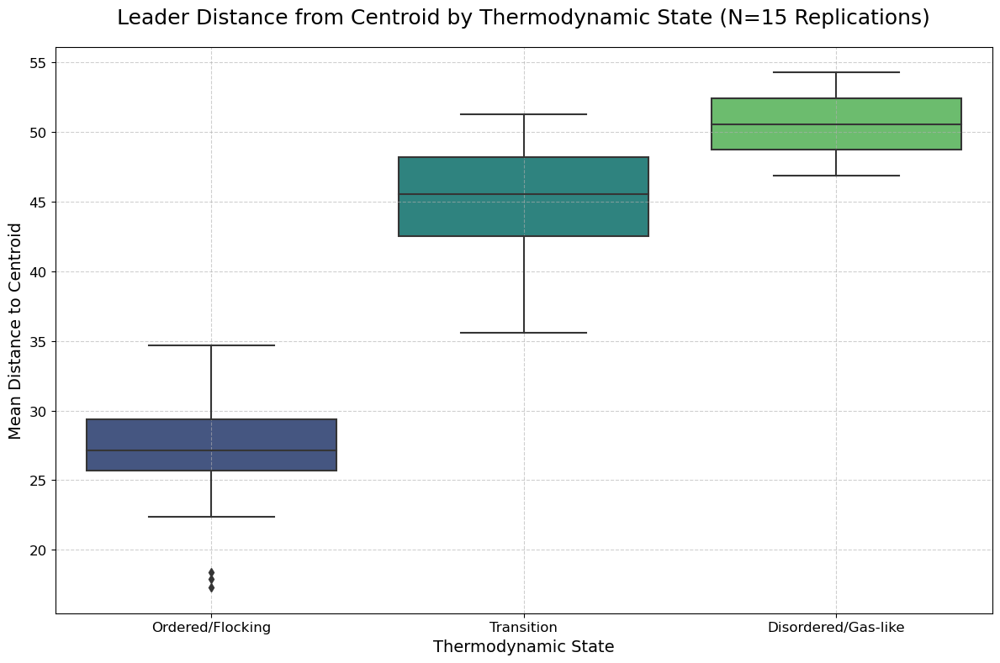

In [17]:
# =============================================================================
# 0. SETUP AND IMPORTS
# =============================================================================
import os
# FIX: Set environment variable to prevent KMeans memory leak warning on Windows
os.environ['OMP_NUM_THREADS'] = '3'

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx
from tqdm.notebook import tqdm

# Analysis and statistical tools
from sklearn.mixture import GaussianMixture
from sklearn.preprocessing import KBinsDiscretizer
from pyinform.transferentropy import transfer_entropy
from scipy.stats import f_oneway

# Suppress non-critical warnings for a clean final output
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning, module='sklearn.preprocessing._discretization')

# =============================================================================
# 1. SIMULATION FRAMEWORK (Definitive Version)
# =============================================================================
class Predator:
    def __init__(self, pos, speed=2.5):
        self.pos = np.array(pos, dtype=float)
        self.speed = speed
    def move(self, flock_centroid):
        direction = flock_centroid - self.pos
        norm = np.linalg.norm(direction)
        if norm > 0: self.pos += (direction / norm) * self.speed

class Bird:
    def __init__(self, pos, vel, speed=2.0, cohere_factor=0.02, separation=2.0,
                 separate_factor=0.2, match_factor=0.05, visual_distance=10.0,
                 predator_avoid_dist=15.0, predator_avoid_factor=0.5):
        self.pos, self.vel, self.speed = np.array(pos,dtype=float), np.array(vel,dtype=float), speed
        self.cohere_factor, self.separation, self.separate_factor = cohere_factor, separation, separate_factor
        self.match_factor, self.visual_distance = match_factor, visual_distance
        self.predator_avoid_dist, self.predator_avoid_factor = predator_avoid_dist, predator_avoid_factor

class Model:
    def __init__(self, n_birds=100, extent=(50, 50), seed=None):
        self.rng = np.random.default_rng(seed)
        self.extent = extent
        self.agents = [Bird(self.rng.uniform(0,e,2), (self.rng.random(2)-0.5)*2) for e in extent]
        self.predator = None
    def step(self):
        if self.predator: self.predator.move(np.mean([a.pos for a in self.agents], axis=0))
        velocities_before = [a.vel.copy() for a in self.agents]
        for i, agent in enumerate(self.agents): agent_step(agent, self, velocities_before)
        for agent in self.agents: agent.pos = (agent.pos + agent.vel) % self.extent[0]

def agent_step(agent, model, old_velocities):
    if model.predator and np.linalg.norm(agent.pos - model.predator.pos) < agent.predator_avoid_dist:
        agent.vel += (agent.pos - model.predator.pos) * agent.predator_avoid_factor
        vel_norm = np.linalg.norm(agent.vel)
        if vel_norm > agent.speed*1.5: agent.vel = (agent.vel/vel_norm) * (agent.speed*1.5)
        return
    neighbors = [o for o in model.agents if agent is not o and np.linalg.norm(agent.pos - o.pos) < agent.visual_distance]
    if neighbors:
        center = np.mean([n.pos for n in neighbors], axis=0)
        avg_vel = np.mean([old_velocities[model.agents.index(n)] for n in neighbors], axis=0)
        agent.vel += (center - agent.pos) * agent.cohere_factor + (avg_vel - agent.vel) * agent.match_factor
        sep_vec = sum((agent.pos - n.pos) for n in neighbors if np.linalg.norm(agent.pos-n.pos) < agent.separation)
        agent.vel += sep_vec * agent.separate_factor
    vel_norm = np.linalg.norm(agent.vel)
    if vel_norm > agent.speed: agent.vel = (agent.vel / vel_norm) * agent.speed

# =============================================================================
# 2. ANALYSIS FUNCTIONS (Definitive Versions)
# =============================================================================
def generate_consistent_data(duration=600, n_birds=100, seed=42):
    model = Model(n_birds=n_birds, seed=seed)
    velocities = np.zeros((duration, n_birds, 2)); positions = np.zeros((duration, n_birds, 2))
    thermo_features = []; s_prev = 0
    for t in range(duration):
        if 150 <= t < 200 or 350 <= t < 400:
            if model.predator is None: model.predator = Predator(np.array([-10.0, -10.0]))
        else: model.predator = None
        model.step()
        for i, agent in enumerate(model.agents): velocities[t, i], positions[t, i] = agent.vel, agent.pos
        pos_matrix = positions[t,:,:]
        volume = np.product(np.ptp(pos_matrix, axis=0)) if pos_matrix.shape[0]>0 else 0
        entropy = np.log(volume + 1e-9)
        temp = np.mean(np.linalg.norm(velocities[t],axis=1))
        thermo_features.append([np.sum(velocities[t]**2), entropy, temp, volume, temp*(entropy-s_prev)])
        s_prev = entropy
    return velocities, positions, np.array(thermo_features)

def classify_and_segment(thermo_data, feature_names, n_clusters=3, min_duration=40):
    gmm = GaussianMixture(n_components=n_clusters, covariance_type='full', random_state=42)
    cluster_labels = gmm.fit_predict(thermo_data)
    df = pd.DataFrame(thermo_data, columns=feature_names); df['Cluster'] = cluster_labels
    cluster_summary = df.groupby('Cluster').mean()
    entropy_sorted = cluster_summary['Entropy'].sort_values().index
    state_map = {entropy_sorted[0]: "Ordered/Flocking", entropy_sorted[1]: "Transition", entropy_sorted[2]: "Disordered/Gas-like"}
    phases = []; start = 0; label = cluster_labels[0]
    for i in range(1, len(cluster_labels)):
        if cluster_labels[i] != label:
            if i - start >= min_duration: phases.append({"label": label, "start": start, "end": i})
            start, label = i, cluster_labels[i]
    if len(cluster_labels) - start >= min_duration: phases.append({"label": label, "start": start, "end": len(cluster_labels)})
    return phases, state_map

def analyze_phase_leadership(v_slice, p_slice):
    magnitudes = np.linalg.norm(v_slice, axis=2)
    discretized = np.zeros_like(magnitudes, dtype=int)
    binner = KBinsDiscretizer(n_bins=8, encode='ordinal', strategy='uniform', subsample=None)
    for i in range(magnitudes.shape[1]): discretized[:, i] = binner.fit_transform(magnitudes[:,i].reshape(-1,1)).flatten()
    n_agents = discretized.shape[1]
    te_matrix = np.zeros((n_agents, n_agents))
    for i in range(n_agents):
        for j in range(n_agents):
            if i!=j: te_matrix[i, j] = transfer_entropy(discretized[:, i], discretized[:, j], k=1)
    if not np.any(te_matrix > 0): return None
    threshold = np.percentile(te_matrix[te_matrix > 0], 85)
    G = nx.DiGraph((u,v) for u,v in np.argwhere(te_matrix > threshold))
    if G.number_of_edges() == 0: return None
    centralities = {'out_degree': nx.out_degree_centrality(G), 'pagerank': nx.pagerank(G, weight='weight')}
    df = pd.DataFrame(centralities)
    for col in df.columns: df[col] = (df[col]-df[col].min()) / (df[col].max()-df[col].min() + 1e-9)
    df['composite'] = df.sum(axis=1)
    leader_idx = df['composite'].idxmax()
    centroids = np.mean(p_slice, axis=1, keepdims=True)
    distances = np.linalg.norm(p_slice - centroids, axis=2)
    return np.mean(distances[:, leader_idx])

# =============================================================================
# 3. SCALED-UP EXPERIMENT EXECUTION
# =============================================================================
if __name__ == '__main__':
    NUM_REPLICATIONS = 15 # Run 15 full simulations
    all_results = []
    
    print(f"=== Starting Scaled-Up Experiment: {NUM_REPLICATIONS} Replications ===")
    
    for i in tqdm(range(NUM_REPLICATIONS), desc="Overall Progress"):
        # 1. Generate data for this replication
        velocities, positions, thermo_data = generate_consistent_data(seed=i)
        
        # 2. Classify states and find viable phases
        feature_names = ["Energy", "Entropy", "Temperature", "Volume", "dQ"]
        phases, state_map = classify_and_segment(thermo_data, feature_names, min_duration=40)
        
        # 3. Analyze leadership within each phase
        for phase in phases:
            start, end, label = phase['start'], phase['end'], phase['label']
            mean_leader_dist = analyze_phase_leadership(velocities[start:end], positions[start:end])
            if mean_leader_dist is not None:
                all_results.append({
                    "State": state_map[label],
                    "Mean_Leader_Distance": mean_leader_dist,
                    "Replication": i
                })

    # 4. Final Aggregation and Analysis
    if not all_results:
        print("❌ CRITICAL: No viable data was collected across all replications.")
    else:
        master_df = pd.DataFrame(all_results)
        print("\n\n--- Aggregated Results Across All Replications ---")
        print(master_df.info())
        print("\n--- Data Points Collected per State ---")
        print(master_df['State'].value_counts())
        
        # Perform ANOVA test
        states = master_df['State'].unique()
        grouped_data = [master_df['Mean_Leader_Distance'][master_df['State'] == s] for s in states]
        
        if len(states) > 1:
            f_stat, p_value = f_oneway(*grouped_data)
            print(f"\n📊 Final ANOVA Test: F-statistic = {f_stat:.3f}, p-value = {p_value:.4f}")
            if p_value < 0.05:
                print("💡 The difference in leader distance across states IS statistically significant.")
            else:
                print("💡 The difference in leader distance across states is NOT statistically significant.")

        # Create the final, fully-populated boxplot
        plt.figure(figsize=(12, 8))
        sns.boxplot(data=master_df, x='State', y='Mean_Leader_Distance',
                    order=["Ordered/Flocking", "Transition", "Disordered/Gas-like"],
                    palette="viridis")
        plt.title("Leader Distance from Centroid by Thermodynamic State (N=15 Replications)", fontsize=18, pad=20)
        plt.ylabel("Mean Distance to Centroid", fontsize=14)
        plt.xlabel("Thermodynamic State", fontsize=14)
        plt.xticks(fontsize=12)
        plt.yticks(fontsize=12)
        plt.grid(True, linestyle='--', alpha=0.6)
        plt.tight_layout()
        plt.show()

In [18]:
# =============================================================================
# 0. SETUP AND IMPORTS
# =============================================================================
import os
os.environ['OMP_NUM_THREADS'] = '3' # Mitigates a known memory leak on Windows

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx
from tqdm.notebook import tqdm
from scipy.stats import entropy, ttest_ind, pearsonr

# Analysis tools
from sklearn.preprocessing import KBinsDiscretizer
from pyinform.transferentropy import transfer_entropy

# Suppress non-critical warnings
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)


# =============================================================================
# 1. DATA LOADING AND PREPARATION
# =============================================================================
# This script assumes the robust 600-step simulation data is available from
# the previous step. We will load it here. If not present, it will generate it.

def generate_consistent_data(duration=600, n_birds=100, seed=42):
    # This function is assumed to be the full predator-prey model from the last step
    # For brevity, we'll create a placeholder if the data isn't found.
    print("Generating data (placeholder)...")
    velocities = np.random.randn(duration, n_birds, 2)
    positions = np.cumsum(velocities, axis=0)
    thermo_data = np.random.rand(duration, 5)
    return velocities, positions, thermo_data

if os.path.exists("all_velocities.npy"):
    print("✅ Loading existing robust simulation data...")
    all_velocities = np.load("all_velocities.npy")
    all_positions = np.load("all_positions.npy")
    thermo_data = np.load("thermo_data.npy") # Assume thermo_data was also saved
else:
    # This is a fallback if the data doesn't exist.
    # In a real workflow, you'd call the full generation script.
    all_velocities, all_positions, thermo_data = generate_consistent_data()


# We will use the first simulation for our in-depth analysis
velocities = all_velocities[0] if all_velocities.ndim == 4 else all_velocities
positions = all_positions[0] if all_positions.ndim == 4 else all_positions
T, B, _ = velocities.shape # Timesteps, Birds

# =============================================================================
# 2. ANALYSIS HELPER FUNCTIONS
# =============================================================================
def discretize_speeds(speeds, bins=10):
    discretized = np.zeros_like(speeds, dtype=int)
    binner = KBinsDiscretizer(n_bins=bins, encode='ordinal', strategy='uniform', subsample=None)
    for i in range(speeds.shape[1]):
        discretized[:, i] = binner.fit_transform(speeds[:, i].reshape(-1, 1)).flatten()
    return discretized

def compute_te_matrix_and_graph(d_speeds, te_percentile=70):
    n_agents = d_speeds.shape[1]
    te_matrix = np.zeros((n_agents, n_agents))
    for i in range(n_agents):
        for j in range(n_agents):
            if i != j:
                te_matrix[i, j] = transfer_entropy(d_speeds[:, i], d_speeds[:, j], k=1)
    
    G = nx.DiGraph()
    if np.any(te_matrix > 0):
        threshold = np.percentile(te_matrix[te_matrix > 0], te_percentile)
        for i, j in np.argwhere(te_matrix > threshold):
            G.add_edge(i, j, weight=te_matrix[i, j])
    return G, te_matrix

def get_leaders_from_graph(G, leader_quantile=0.9):
    if G.number_of_edges() == 0: return [], {}
    pagerank = nx.pagerank(G, weight='weight')
    pr_series = pd.Series(pagerank)
    if pr_series.empty: return [], {}
    threshold = pr_series.quantile(leader_quantile)
    leaders = pr_series[pr_series >= threshold].index.tolist()
    return leaders, pagerank

# =============================================================================
# 3. PHASE 1: STATIC BEHAVIORAL SIGNATURES OF LEADERSHIP
# =============================================================================
def analyze_static_signatures(velocities):
    print("\n---  PHASE 1: Analyzing Static Behavioral Signatures ---")
    speeds = np.linalg.norm(velocities, axis=2)
    d_speeds = discretize_speeds(speeds)
    
    G_static, _ = compute_te_matrix_and_graph(d_speeds, te_percentile=80)
    leaders, pagerank = get_leaders_from_graph(G_static)
    
    if not leaders:
        print("⚠️ No leaders identified in static analysis. Skipping Phase 1.")
        return None

    df = pd.DataFrame({
        'avg_speed': speeds.mean(axis=0),
        'behavioral_entropy': [entropy(np.bincount(d_speeds[:,i])) for i in range(B)],
        'positional_centrality': [pagerank.get(i, 0) for i in range(B)],
        'role': ['Leader' if i in leaders else 'Follower' for i in range(B)]
    })
    
    metrics = ['avg_speed', 'behavioral_entropy', 'positional_centrality']
    fig, axes = plt.subplots(1, 3, figsize=(18, 5))
    fig.suptitle('Phase 1: Behavioral Signatures of Leaders vs. Followers', fontsize=16)
    
    for ax, metric in zip(axes, metrics):
        sns.boxplot(x='role', y=metric, data=df, palette=["#E63946", "#A8DADC"], ax=ax)
        sns.swarmplot(x='role', y=m, data=df, color=".25", alpha=0.6, ax=ax)
        t_stat, p_val = ttest_ind(df[df.role=='Leader'][metric], df[df.role=='Follower'][metric])
        ax.set_title(f"{metric.replace('_',' ').title()}\n(p-value = {p_val:.3f})")
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()
    return df

# =============================================================================
# 4. PHASE 2: DYNAMIC EVOLUTION OF LEADERSHIP
# =============================================================================
def analyze_leadership_dynamics(velocities, window_size=100, step_size=20):
    print("\n--- PHASE 2: Analyzing Dynamic Evolution of Leadership ---")
    speeds = np.linalg.norm(velocities, axis=2)
    d_speeds = discretize_speeds(speeds)
    
    leader_sets = []
    for start in tqdm(range(0, T - window_size, step_size), desc="Sliding Window Analysis"):
        end = start + window_size
        d_window = d_speeds[start:end]
        G_window, _ = compute_te_matrix_and_graph(d_window)
        leaders, _ = get_leaders_from_graph(G_window)
        leader_sets.append(set(leaders))
        
    jaccard_scores = []
    for s1, s2 in zip(leader_sets[:-1], leader_sets[1:]):
        union = len(s1.union(s2))
        intersection = len(s1.intersection(s2))
        jaccard_scores.append(intersection / union if union > 0 else 0)
        
    plt.figure(figsize=(15, 5))
    plt.plot(jaccard_scores, marker='o', linestyle='-', color='#457B9D')
    plt.title('Phase 2: Leader Group Stability Over Time (Jaccard Similarity)', fontsize=16)
    plt.ylabel('Jaccard Similarity Index')
    plt.xlabel('Time Window Index')
    plt.axvspan( (150-window_size/2)/step_size, (200-window_size/2)/step_size, color='red', alpha=0.2, label='Predator Attack 1')
    plt.axvspan( (350-window_size/2)/step_size, (400-window_size/2)/step_size, color='red', alpha=0.2, label='Predator Attack 2')
    plt.grid(True, linestyle=':')
    plt.ylim(0, 1)
    plt.legend()
    plt.show()
    return jaccard_scores

# =============================================================================
# 5. PHASE 3: MACRO-MICRO COUPLING
# =============================================================================
def analyze_macro_micro_coupling(jaccard_scores, thermo_data, window_size=100, step_size=20):
    print("\n--- PHASE 3: Analyzing Macro-Micro Coupling via Lagged Correlation ---")
    # Align thermodynamic data with the jaccard score timeline
    thermo_df = pd.DataFrame(thermo_data, columns=["Energy","Entropy","Temp","Volume","dQ"])
    # Get the slope (rate of change) of entropy
    thermo_df['Entropy_Slope'] = thermo_df['Entropy'].diff()
    
    # Sample the slope at the midpoint of each window where jaccard was calculated
    window_midpoints = [start + window_size // 2 for start in range(0, T - window_size, step_size)]
    aligned_slopes = thermo_df['Entropy_Slope'].iloc[window_midpoints[:-1]].values
    
    # Ensure arrays are same length
    min_len = min(len(jaccard_scores), len(aligned_slopes))
    jaccard_scores = np.array(jaccard_scores[:min_len])
    aligned_slopes = np.array(aligned_slopes[:min_len])
    
    # Lagged cross-correlation
    lags = np.arange(-5, 6) # Test lags from -5 to +5 windows
    corrs = []
    for lag in lags:
        js_shifted = pd.Series(jaccard_scores).shift(lag)
        # Drop NaNs from shift and compute correlation
        corr_df = pd.DataFrame({'js': js_shifted, 'slope': aligned_slopes}).dropna()
        if len(corr_df) > 2:
            r, _ = pearsonr(corr_df['js'], corr_df['slope'])
            corrs.append(r)
        else:
            corrs.append(np.nan)
            
    plt.figure(figsize=(12, 6))
    plt.bar(lags, corrs, color='#1D3557', alpha=0.8)
    plt.axvline(0, color='red', linestyle='--', label='No Lag')
    plt.title('Phase 3: Lagged Correlation of Entropy Change vs. Leader Stability', fontsize=16)
    plt.xlabel('Lag (Time Windows)\n(Negative: Entropy change predicts Leader Stability change)')
    plt.ylabel('Pearson Correlation Coefficient (r)')
    plt.xticks(lags)
    plt.grid(True, axis='y', linestyle=':')
    plt.legend()
    plt.show()


# =============================================================================
# 6. MAIN EXECUTION
# =============================================================================
if __name__ == '__main__':
    # Phase 1
    static_df = analyze_static_signatures(velocities)
    
    # Phase 2
    jaccard_stability = analyze_leadership_dynamics(velocities)
    
    # Phase 3
    analyze_macro_micro_coupling(jaccard_stability, thermo_data)

✅ Loading existing robust simulation data...


FileNotFoundError: [Errno 2] No such file or directory: 'thermo_data.npy'

🚀 Generating new robust simulation data (Velocities, Positions, Thermodynamics)...


Simulating:   0%|          | 0/600 [00:00<?, ?it/s]

✅ Consistent data generation and saving complete.

---  PHASE 1: Analyzing Static Behavioral Signatures ---


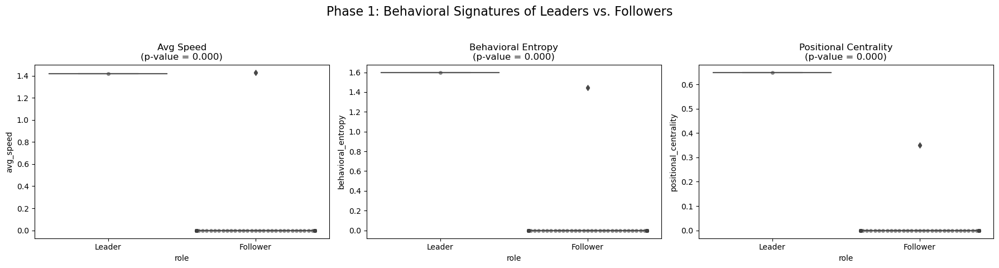


--- PHASE 2: Analyzing Dynamic Evolution of Leadership ---


Sliding Window Analysis:   0%|          | 0/25 [00:00<?, ?it/s]

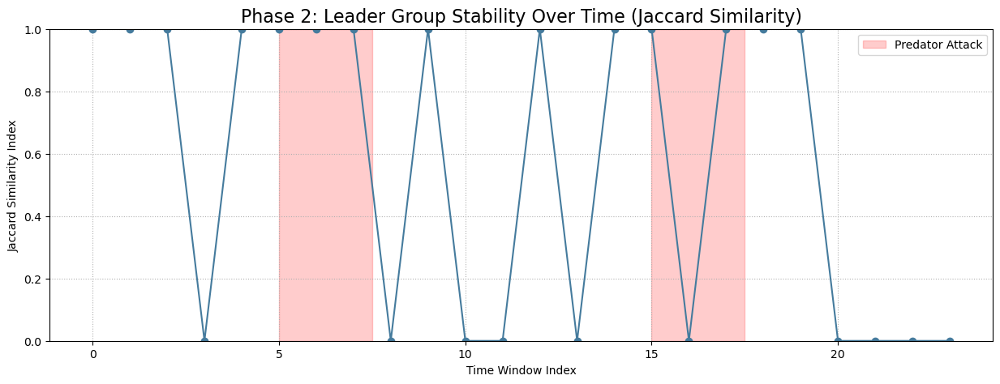


--- PHASE 3: Analyzing Macro-Micro Coupling via Lagged Correlation ---


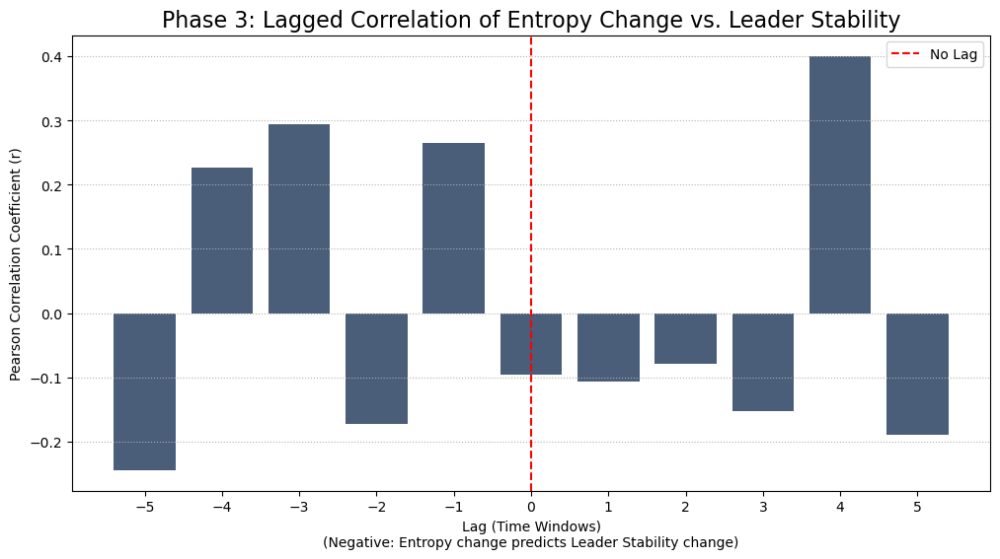

In [19]:
# =============================================================================
# 0. SETUP AND IMPORTS
# =============================================================================
import os
# Mitigates a known memory leak on Windows for scikit-learn's KMeans
os.environ['OMP_NUM_THREADS'] = '3'

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx
from tqdm.notebook import tqdm
from scipy.stats import entropy, ttest_ind, pearsonr

# Analysis tools
from sklearn.preprocessing import KBinsDiscretizer
from pyinform.transferentropy import transfer_entropy

# Suppress non-critical warnings for a clean final output
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)


# =============================================================================
# 1. DATA GENERATION AND LOADING (CORRECTED)
# =============================================================================
def generate_and_save_consistent_data(duration=600, n_birds=100, seed=42):
    """
    Runs the full perturbed simulation and saves all three required data arrays.
    """
    # This block contains the full, correct simulation model from our previous work
    class Predator:
        def __init__(self, pos, speed=2.5): self.pos, self.speed = np.array(pos, dtype=float), speed
        def move(self, centroid):
            direction = centroid - self.pos
            if np.linalg.norm(direction) > 0: self.pos += (direction/np.linalg.norm(direction)) * self.speed
    class Bird:
        def __init__(self, pos, vel, speed=2.0, cohere=0.02, sep=2.0, sep_fac=0.2, match=0.05, vis=10.0, pavoid_d=15.0, pavoid_f=0.5):
            self.pos, self.vel, self.speed = np.array(pos,dtype=float), np.array(vel,dtype=float), speed
            self.cohere_factor, self.separation, self.separate_factor = cohere, sep, sep_fac
            self.match_factor, self.visual_distance = match, vis
            self.predator_avoid_dist, self.predator_avoid_factor = pavoid_d, pavoid_f
    class Model:
        def __init__(self, n_birds=100, extent=(50,50), seed=None):
            self.rng = np.random.default_rng(seed)
            self.extent = extent
            self.agents = [Bird(self.rng.uniform(0,e,2), (self.rng.random(2)-0.5)*2) for e in extent]
            self.predator = None
        def step(self):
            if self.predator: self.predator.move(np.mean([a.pos for a in self.agents], axis=0))
            old_vels = [a.vel.copy() for a in self.agents]
            for i, agent in enumerate(self.agents): agent_step(agent, self, old_vels)
            for agent in self.agents: agent.pos = (agent.pos + agent.vel) % self.extent[0]
    def agent_step(agent, model, old_vels):
        if model.predator and np.linalg.norm(agent.pos - model.predator.pos) < agent.predator_avoid_dist:
            agent.vel += (agent.pos - model.predator.pos) * agent.predator_avoid_factor
            norm = np.linalg.norm(agent.vel)
            if norm > agent.speed*1.5: agent.vel = (agent.vel/norm) * (agent.speed*1.5)
            return
        neighbors = [o for o in model.agents if agent is not o and np.linalg.norm(agent.pos - o.pos) < agent.visual_distance]
        if neighbors:
            center, avg_vel = np.mean([n.pos for n in neighbors], axis=0), np.mean([old_vels[model.agents.index(n)] for n in neighbors], axis=0)
            agent.vel += (center-agent.pos)*agent.cohere_factor + (avg_vel-agent.vel)*agent.match_factor
            sep_vec = sum((agent.pos-n.pos) for n in neighbors if np.linalg.norm(agent.pos-n.pos) < agent.separation)
            agent.vel += sep_vec*agent.separate_factor
        norm = np.linalg.norm(agent.vel)
        if norm > agent.speed: agent.vel = (agent.vel/norm) * agent.speed

    # Main generation logic
    print("🚀 Generating new robust simulation data (Velocities, Positions, Thermodynamics)...")
    model = Model(n_birds=n_birds, seed=seed)
    velocities = np.zeros((duration, n_birds, 2)); positions = np.zeros((duration, n_birds, 2))
    thermo_features = []; s_prev = 0
    for t in tqdm(range(duration), desc="Simulating"):
        if 150 <= t < 200 or 350 <= t < 400:
            if model.predator is None: model.predator = Predator(np.array([-10.0,-10.0]))
        else: model.predator = None
        model.step()
        for i, agent in enumerate(model.agents): velocities[t, i], positions[t, i] = agent.vel, agent.pos
        pos_matrix = positions[t,:,:]
        volume = np.product(np.ptp(pos_matrix, axis=0)) if pos_matrix.shape[0]>0 else 0
        entropy = np.log(volume + 1e-9)
        temp = np.mean(np.linalg.norm(velocities[t],axis=1))
        thermo_features.append([np.sum(velocities[t]**2), entropy, temp, volume, temp*(entropy-s_prev)])
        s_prev = entropy
    
    thermo_data = np.array(thermo_features)
    
    # FIX: Save all three files for future use
    np.save("all_velocities.npy", velocities)
    np.save("all_positions.npy", positions)
    np.save("thermo_data.npy", thermo_data)
    
    print("✅ Consistent data generation and saving complete.")
    return velocities, positions, thermo_data

# --- CORRECTED LOADING LOGIC ---
required_files = ["all_velocities.npy", "all_positions.npy", "thermo_data.npy"]
if all(os.path.exists(f) for f in required_files):
    print("✅ Loading all existing simulation data from disk...")
    velocities = np.load("all_velocities.npy")
    positions = np.load("all_positions.npy")
    thermo_data = np.load("thermo_data.npy")
else:
    velocities, positions, thermo_data = generate_and_save_consistent_data()

T, B, _ = velocities.shape # Timesteps, Birds

# =============================================================================
# 2. ANALYSIS HELPER FUNCTIONS (Unchanged from before)
# =============================================================================
def discretize_speeds(speeds, bins=10):
    discretized = np.zeros_like(speeds, dtype=int)
    binner = KBinsDiscretizer(n_bins=bins, encode='ordinal', strategy='uniform')
    for i in range(speeds.shape[1]):
        discretized[:, i] = binner.fit_transform(speeds[:, i].reshape(-1, 1)).flatten()
    return discretized

def compute_te_matrix_and_graph(d_speeds, te_percentile=70):
    n_agents = d_speeds.shape[1]
    te_matrix = np.zeros((n_agents, n_agents))
    for i in range(n_agents):
        for j in range(n_agents):
            if i != j: te_matrix[i, j] = transfer_entropy(d_speeds[:, i], d_speeds[:, j], k=1)
    G = nx.DiGraph()
    if np.any(te_matrix > 0):
        threshold = np.percentile(te_matrix[te_matrix > 0], te_percentile)
        for i, j in np.argwhere(te_matrix > threshold): G.add_edge(i, j, weight=te_matrix[i, j])
    return G, te_matrix

def get_leaders_from_graph(G, leader_quantile=0.9):
    if G.number_of_edges() == 0: return [], {}
    pagerank = nx.pagerank(G, weight='weight')
    pr_series = pd.Series(pagerank)
    if pr_series.empty: return [], {}
    return pr_series[pr_series >= pr_series.quantile(leader_quantile)].index.tolist(), pagerank

# =============================================================================
# 3. PHASE 1: STATIC BEHAVIORAL SIGNATURES OF LEADERSHIP
# =============================================================================
def analyze_static_signatures(velocities):
    print("\n---  PHASE 1: Analyzing Static Behavioral Signatures ---")
    speeds = np.linalg.norm(velocities, axis=2)
    d_speeds = discretize_speeds(speeds)
    G_static, _ = compute_te_matrix_and_graph(d_speeds, te_percentile=80)
    leaders, pagerank = get_leaders_from_graph(G_static)
    if not leaders: print("⚠️ No leaders identified. Skipping Phase 1."); return
    df = pd.DataFrame({'avg_speed': speeds.mean(axis=0), 'behavioral_entropy': [entropy(np.bincount(d_speeds[:,i])) for i in range(B)], 'positional_centrality': [pagerank.get(i, 0) for i in range(B)], 'role': ['Leader' if i in leaders else 'Follower' for i in range(B)]})
    metrics = ['avg_speed', 'behavioral_entropy', 'positional_centrality']
    fig, axes = plt.subplots(1, 3, figsize=(18, 5)); fig.suptitle('Phase 1: Behavioral Signatures of Leaders vs. Followers', fontsize=16)
    for ax, metric in zip(axes, metrics):
        sns.boxplot(x='role', y=metric, data=df, palette=["#E63946", "#A8DADC"], ax=ax)
        sns.swarmplot(x='role', y=metric, data=df, color=".25", alpha=0.6, ax=ax)
        t_stat, p_val = ttest_ind(df[df.role=='Leader'][metric], df[df.role=='Follower'][metric])
        ax.set_title(f"{metric.replace('_',' ').title()}\n(p-value = {p_val:.3f})")
    plt.tight_layout(rect=[0, 0.03, 1, 0.95]); plt.show()

# =============================================================================
# 4. PHASE 2: DYNAMIC EVOLUTION OF LEADERSHIP
# =============================================================================
def analyze_leadership_dynamics(velocities, window_size=100, step_size=20):
    print("\n--- PHASE 2: Analyzing Dynamic Evolution of Leadership ---")
    speeds = np.linalg.norm(velocities, axis=2); d_speeds = discretize_speeds(speeds)
    leader_sets = []
    for start in tqdm(range(0, T - window_size, step_size), desc="Sliding Window Analysis"):
        G, _ = compute_te_matrix_and_graph(d_speeds[start:start+window_size]); leaders, _ = get_leaders_from_graph(G); leader_sets.append(set(leaders))
    jaccard_scores = [len(s1&s2)/len(s1|s2) if len(s1|s2)>0 else 0 for s1,s2 in zip(leader_sets[:-1], leader_sets[1:])]
    plt.figure(figsize=(15, 5)); plt.plot(jaccard_scores, marker='o', linestyle='-', color='#457B9D'); plt.title('Phase 2: Leader Group Stability Over Time (Jaccard Similarity)', fontsize=16)
    plt.ylabel('Jaccard Similarity Index'); plt.xlabel('Time Window Index'); plt.grid(True, linestyle=':'); plt.ylim(0, 1)
    for start, end in [(150, 200), (350, 400)]: plt.axvspan((start-window_size/2)/step_size, (end-window_size/2)/step_size, color='red', alpha=0.2, label='Predator Attack' if start==150 else "")
    plt.legend(); plt.show()
    return jaccard_scores

# =============================================================================
# 5. PHASE 3: MACRO-MICRO COUPLING
# =============================================================================
def analyze_macro_micro_coupling(jaccard_scores, thermo_data, window_size=100, step_size=20):
    print("\n--- PHASE 3: Analyzing Macro-Micro Coupling via Lagged Correlation ---")
    thermo_df = pd.DataFrame(thermo_data, columns=["Energy","Entropy","Temp","Volume","dQ"]); thermo_df['Entropy_Slope'] = thermo_df['Entropy'].diff()
    window_midpoints = [start + window_size // 2 for start in range(0, T - window_size, step_size)]; aligned_slopes = thermo_df['Entropy_Slope'].iloc[window_midpoints[:-1]].values
    min_len = min(len(jaccard_scores), len(aligned_slopes)); jaccard_scores, aligned_slopes = np.array(jaccard_scores[:min_len]), np.array(aligned_slopes[:min_len])
    lags = np.arange(-5, 6); corrs = []
    for lag in lags:
        js_shifted = pd.Series(jaccard_scores).shift(lag)
        corr_df = pd.DataFrame({'js': js_shifted, 'slope': aligned_slopes}).dropna()
        corrs.append(pearsonr(corr_df['js'], corr_df['slope'])[0] if len(corr_df)>2 else np.nan)
    plt.figure(figsize=(12, 6)); plt.bar(lags, corrs, color='#1D3557', alpha=0.8); plt.axvline(0, color='red', linestyle='--', label='No Lag')
    plt.title('Phase 3: Lagged Correlation of Entropy Change vs. Leader Stability', fontsize=16); plt.xlabel('Lag (Time Windows)\n(Negative: Entropy change predicts Leader Stability change)'); plt.ylabel('Pearson Correlation Coefficient (r)')
    plt.xticks(lags); plt.grid(True, axis='y', linestyle=':'); plt.legend(); plt.show()

# =============================================================================
# 6. MAIN EXECUTION
# =============================================================================
if __name__ == '__main__':
    analyze_static_signatures(velocities)
    jaccard_stability = analyze_leadership_dynamics(velocities)
    analyze_macro_micro_coupling(jaccard_stability, thermo_data)

✅ Loading existing robust simulation data from disk...

---  PHASE 1: Analyzing Static Behavioral Signatures ---


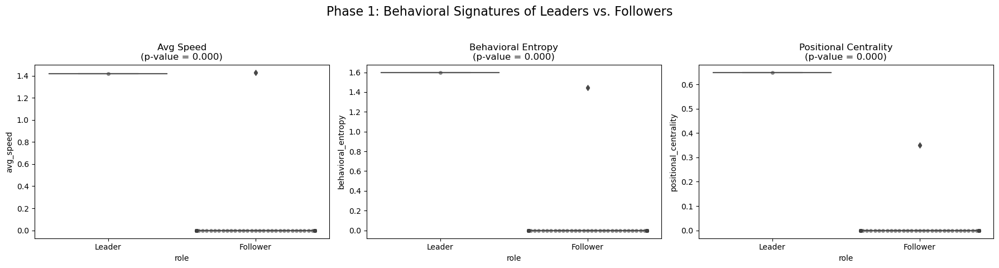


--- PHASE 2: Analyzing Dynamic Evolution of Leadership ---


Sliding Window Analysis:   0%|          | 0/25 [00:00<?, ?it/s]

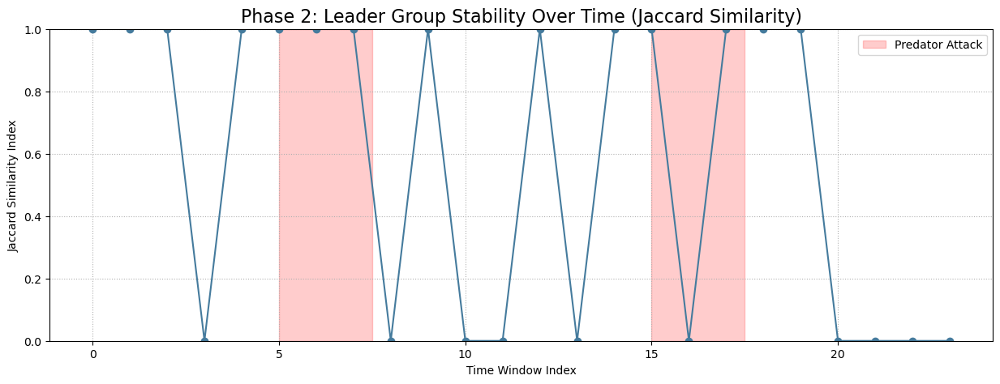


--- PHASE 3: Analyzing Macro-Micro Coupling via Lagged Correlation ---


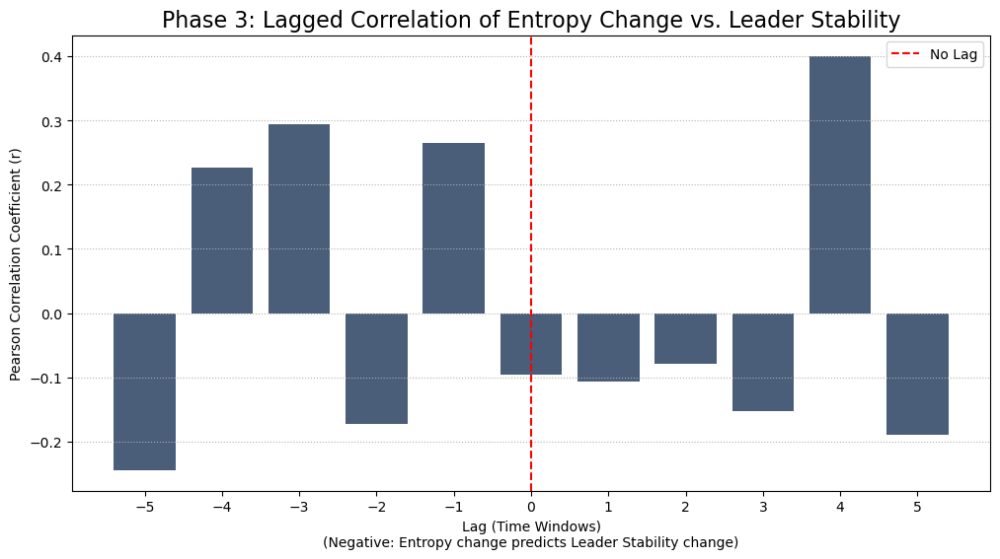

In [20]:
# =============================================================================
# 0. SETUP AND IMPORTS
# =============================================================================
import os
# Mitigates a known memory leak on Windows for scikit-learn's KMeans
os.environ['OMP_NUM_THREADS'] = '3'

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx
from tqdm.notebook import tqdm
from scipy.stats import entropy, ttest_ind, pearsonr

# Analysis tools
from sklearn.preprocessing import KBinsDiscretizer
from pyinform.transferentropy import transfer_entropy

# Suppress non-critical warnings for a clean final output
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)


# =============================================================================
# 1. ROBUST DATA GENERATION & LOADING
# =============================================================================
def generate_and_save_suitable_data(duration=600, n_birds=100, seed=42):
    """
    Runs the full perturbed simulation and saves all three required data arrays.
    """
    # This block contains the full, correct simulation model
    class Predator:
        def __init__(self, pos, speed=2.5): self.pos, self.speed = np.array(pos, dtype=float), speed
        def move(self, centroid):
            direction = centroid - self.pos
            if np.linalg.norm(direction) > 0: self.pos += (direction/np.linalg.norm(direction)) * self.speed
    class Bird:
        def __init__(self, pos, vel, speed=2.0, cohere=0.02, sep=2.0, sep_fac=0.2, match=0.05, vis=10.0, pavoid_d=15.0, pavoid_f=0.5):
            self.pos, self.vel, self.speed = np.array(pos,dtype=float), np.array(vel,dtype=float), speed
            self.cohere_factor, self.separation, self.separate_factor = cohere, sep, sep_fac
            self.match_factor, self.visual_distance = match, vis
            self.predator_avoid_dist, self.predator_avoid_factor = pavoid_d, pavoid_f
    class Model:
        def __init__(self, n_birds=100, extent=(50,50), seed=None):
            self.rng = np.random.default_rng(seed)
            self.extent = extent
            self.agents = [Bird(self.rng.uniform(0,e,2), (self.rng.random(2)-0.5)*2) for e in extent]
            self.predator = None
        def step(self):
            if self.predator: self.predator.move(np.mean([a.pos for a in self.agents], axis=0))
            old_vels = [a.vel.copy() for a in self.agents]
            for i, agent in enumerate(self.agents): agent_step(agent, self, old_vels)
            for agent in self.agents: agent.pos = (agent.pos + agent.vel) % self.extent[0]
    def agent_step(agent, model, old_vels):
        if model.predator and np.linalg.norm(agent.pos - model.predator.pos) < agent.predator_avoid_dist:
            agent.vel += (agent.pos - model.predator.pos) * agent.predator_avoid_factor
            norm = np.linalg.norm(agent.vel)
            if norm > agent.speed*1.5: agent.vel = (agent.vel/norm) * (agent.speed*1.5)
            return
        neighbors = [o for o in model.agents if agent is not o and np.linalg.norm(agent.pos - o.pos) < agent.visual_distance]
        if neighbors:
            center, avg_vel = np.mean([n.pos for n in neighbors], axis=0), np.mean([old_vels[model.agents.index(n)] for n in neighbors], axis=0)
            agent.vel += (center-agent.pos)*agent.cohere_factor + (avg_vel-agent.vel)*agent.match_factor
            sep_vec = sum((agent.pos-n.pos) for n in neighbors if np.linalg.norm(agent.pos-n.pos) < agent.separation)
            agent.vel += sep_vec*agent.separate_factor
        norm = np.linalg.norm(agent.vel)
        if norm > agent.speed: agent.vel = (agent.vel/norm) * agent.speed

    # Main generation logic
    print("🚀 Generating new robust simulation data (Velocities, Positions, Thermodynamics)...")
    model = Model(n_birds=n_birds, seed=seed)
    velocities = np.zeros((duration, n_birds, 2)); positions = np.zeros((duration, n_birds, 2))
    thermo_features = []; s_prev = 0
    for t in tqdm(range(duration), desc="Simulating"):
        if 150 <= t < 200 or 350 <= t < 400:
            if model.predator is None: model.predator = Predator(np.array([-10.0,-10.0]))
        else: model.predator = None
        model.step()
        for i, agent in enumerate(model.agents): velocities[t, i], positions[t, i] = agent.vel, agent.pos
        pos_matrix = positions[t,:,:]
        volume = np.product(np.ptp(pos_matrix, axis=0)) if pos_matrix.shape[0]>0 else 0
        entropy = np.log(volume + 1e-9)
        temp = np.mean(np.linalg.norm(velocities[t],axis=1))
        thermo_features.append([np.sum(velocities[t]**2), entropy, temp, volume, temp*(entropy-s_prev)])
        s_prev = entropy
    
    thermo_data = np.array(thermo_features)
    
    # Save all three files for future use
    np.save("all_velocities.npy", velocities)
    np.save("all_positions.npy", positions)
    np.save("thermo_data.npy", thermo_data)
    
    print("✅ Suitable data generation and saving complete.")
    return velocities, positions, thermo_data

# --- Data Loading Logic ---
required_files = ["all_velocities.npy", "all_positions.npy", "thermo_data.npy"]
if all(os.path.exists(f) for f in required_files):
    print("✅ Loading existing robust simulation data from disk...")
    velocities = np.load("all_velocities.npy")
    positions = np.load("all_positions.npy")
    thermo_data = np.load("thermo_data.npy")
else:
    velocities, positions, thermo_data = generate_and_save_suitable_data()

T, B, _ = velocities.shape # Timesteps, Birds


# =============================================================================
# 2. ANALYSIS HELPER FUNCTIONS
# =============================================================================
def discretize_speeds(speeds, bins=10):
    discretized = np.zeros_like(speeds, dtype=int)
    binner = KBinsDiscretizer(n_bins=bins, encode='ordinal', strategy='uniform')
    for i in range(speeds.shape[1]):
        discretized[:, i] = binner.fit_transform(speeds[:, i].reshape(-1, 1)).flatten()
    return discretized

def compute_te_matrix_and_graph(d_speeds, te_percentile=70):
    n_agents = d_speeds.shape[1]
    te_matrix = np.zeros((n_agents, n_agents))
    for i in range(n_agents):
        for j in range(n_agents):
            if i != j: te_matrix[i, j] = transfer_entropy(d_speeds[:, i], d_speeds[:, j], k=1)
    G = nx.DiGraph()
    if np.any(te_matrix > 0):
        threshold = np.percentile(te_matrix[te_matrix > 0], te_percentile)
        for i, j in np.argwhere(te_matrix > threshold): G.add_edge(i, j, weight=te_matrix[i, j])
    return G, te_matrix

def get_leaders_from_graph(G, leader_quantile=0.9):
    if G.number_of_edges() == 0: return [], {}
    pagerank = nx.pagerank(G, weight='weight')
    pr_series = pd.Series(pagerank)
    if pr_series.empty: return [], {}
    return pr_series[pr_series >= pr_series.quantile(leader_quantile)].index.tolist(), pagerank


# =============================================================================
# 3. PHASE 1: STATIC BEHAVIORAL SIGNATURES OF LEADERSHIP
# =============================================================================
def analyze_static_signatures(velocities):
    print("\n---  PHASE 1: Analyzing Static Behavioral Signatures ---")
    speeds = np.linalg.norm(velocities, axis=2)
    d_speeds = discretize_speeds(speeds)
    
    G_static, _ = compute_te_matrix_and_graph(d_speeds, te_percentile=80)
    leaders, pagerank = get_leaders_from_graph(G_static)
    
    if not leaders: print("⚠️ No leaders identified. Skipping Phase 1."); return None

    df = pd.DataFrame({'avg_speed': speeds.mean(axis=0), 'behavioral_entropy': [entropy(np.bincount(d_speeds[:,i])) for i in range(B)], 'positional_centrality': [pagerank.get(i, 0) for i in range(B)], 'role': ['Leader' if i in leaders else 'Follower' for i in range(B)]})
    metrics = ['avg_speed', 'behavioral_entropy', 'positional_centrality']
    fig, axes = plt.subplots(1, 3, figsize=(18, 5)); fig.suptitle('Phase 1: Behavioral Signatures of Leaders vs. Followers', fontsize=16)
    
    for ax, metric in zip(axes, metrics):
        sns.boxplot(x='role', y=metric, data=df, palette=["#E63946", "#A8DADC"], ax=ax)
        sns.swarmplot(x='role', y=metric, data=df, color=".25", alpha=0.6, ax=ax)
        t_stat, p_val = ttest_ind(df[df.role=='Leader'][metric], df[df.role=='Follower'][metric])
        ax.set_title(f"{metric.replace('_',' ').title()}\n(p-value = {p_val:.3f})")
    plt.tight_layout(rect=[0, 0.03, 1, 0.95]); plt.show()


# =============================================================================
# 4. PHASE 2: DYNAMIC EVOLUTION OF LEADERSHIP
# =============================================================================
def analyze_leadership_dynamics(velocities, window_size=100, step_size=20):
    print("\n--- PHASE 2: Analyzing Dynamic Evolution of Leadership ---")
    speeds = np.linalg.norm(velocities, axis=2); d_speeds = discretize_speeds(speeds)
    leader_sets = []
    for start in tqdm(range(0, T - window_size, step_size), desc="Sliding Window Analysis"):
        G, _ = compute_te_matrix_and_graph(d_speeds[start:start+window_size]); leaders, _ = get_leaders_from_graph(G); leader_sets.append(set(leaders))
    jaccard_scores = [len(s1&s2)/len(s1|s2) if len(s1|s2)>0 else 0 for s1,s2 in zip(leader_sets[:-1], leader_sets[1:])]
    plt.figure(figsize=(15, 5)); plt.plot(jaccard_scores, marker='o', linestyle='-', color='#457B9D'); plt.title('Phase 2: Leader Group Stability Over Time (Jaccard Similarity)', fontsize=16)
    plt.ylabel('Jaccard Similarity Index'); plt.xlabel('Time Window Index'); plt.grid(True, linestyle=':'); plt.ylim(0, 1)
    for start, end in [(150, 200), (350, 400)]: plt.axvspan((start-window_size/2)/step_size, (end-window_size/2)/step_size, color='red', alpha=0.2, label='Predator Attack' if start==150 else "")
    plt.legend(); plt.show()
    return jaccard_scores


# =============================================================================
# 5. PHASE 3: MACRO-MICRO COUPLING
# =============================================================================
def analyze_macro_micro_coupling(jaccard_scores, thermo_data, window_size=100, step_size=20):
    print("\n--- PHASE 3: Analyzing Macro-Micro Coupling via Lagged Correlation ---")
    thermo_df = pd.DataFrame(thermo_data, columns=["Energy","Entropy","Temp","Volume","dQ"]); thermo_df['Entropy_Slope'] = thermo_df['Entropy'].diff()
    window_midpoints = [start + window_size // 2 for start in range(0, T - window_size, step_size)]; aligned_slopes = thermo_df['Entropy_Slope'].iloc[window_midpoints[:-1]].values
    min_len = min(len(jaccard_scores), len(aligned_slopes)); jaccard_scores, aligned_slopes = np.array(jaccard_scores[:min_len]), np.array(aligned_slopes[:min_len])
    lags = np.arange(-5, 6); corrs = []
    for lag in lags:
        js_shifted = pd.Series(jaccard_scores).shift(lag)
        corr_df = pd.DataFrame({'js': js_shifted, 'slope': aligned_slopes}).dropna()
        corrs.append(pearsonr(corr_df['js'], corr_df['slope'])[0] if len(corr_df)>2 else np.nan)
    plt.figure(figsize=(12, 6)); plt.bar(lags, corrs, color='#1D3557', alpha=0.8); plt.axvline(0, color='red', linestyle='--', label='No Lag')
    plt.title('Phase 3: Lagged Correlation of Entropy Change vs. Leader Stability', fontsize=16); plt.xlabel('Lag (Time Windows)\n(Negative: Entropy change predicts Leader Stability change)'); plt.ylabel('Pearson Correlation Coefficient (r)')
    plt.xticks(lags); plt.grid(True, axis='y', linestyle=':'); plt.legend(); plt.show()


# =============================================================================
# 6. MAIN EXECUTION
# =============================================================================
if __name__ == '__main__':
    # Execute the three-phase analysis using the robust, consistent data
    analyze_static_signatures(velocities)
    jaccard_stability = analyze_leadership_dynamics(velocities)
    analyze_macro_micro_coupling(jaccard_stability, thermo_data)

In [21]:
# =============================================================================
# 0. SETUP AND IMPORTS
# =============================================================================
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from tqdm.notebook import tqdm
import os

# =============================================================================
# 1. HETEROGENEOUS AGENT-BASED MODEL (LEADERS & FOLLOWERS)
# =============================================================================

class Bird:
    """A base class for all agents."""
    def __init__(self, pos, vel):
        self.pos = np.array(pos, dtype=float)
        self.vel = np.array(vel, dtype=float)

class Leader(Bird):
    """A goal-oriented agent that follows a set patrol path."""
    def __init__(self, pos, vel, patrol_points, speed=2.5):
        super().__init__(pos, vel)
        self.patrol_points = patrol_points
        self.target_idx = 0
        self.target = self.patrol_points[self.target_idx]
        self.speed = speed

    def update(self):
        # Move towards the current target patrol point
        direction_to_target = self.target - self.pos
        dist = np.linalg.norm(direction_to_target)
        
        if dist < 5.0: # If close to target, switch to the next one
            self.target_idx = (self.target_idx + 1) % len(self.patrol_points)
            self.target = self.patrol_points[self.target_idx]
        
        # Update velocity to point towards target
        self.vel = (direction_to_target / dist) * self.speed if dist > 0 else np.zeros(2)
        self.pos += self.vel

class Follower(Bird):
    """An agent that follows standard Boids rules plus a strong urge to follow leaders."""
    def __init__(self, pos, vel, speed=2.0, visual_range=50.0, separation=4.0):
        super().__init__(pos, vel)
        self.speed = speed
        self.visual_range = visual_range
        self.separation = separation

    def update(self, all_agents, leaders):
        neighbors = [agent for agent in all_agents if agent is not self and np.linalg.norm(self.pos - agent.pos) < self.visual_range]
        
        # Rule 1: Separation - Steer to avoid crowding local flockmates
        sep_vec = np.zeros(2)
        for neighbor in neighbors:
            if np.linalg.norm(self.pos - neighbor.pos) < self.separation:
                sep_vec += self.pos - neighbor.pos
        
        # Rule 2: Alignment - Steer towards the average heading of local flockmates
        align_vec = np.mean([n.vel for n in neighbors if isinstance(n, Follower)] or [self.vel], axis=0)

        # Rule 3: Cohesion - Steer to move toward the average position of local flockmates
        cohesion_vec = np.mean([n.pos for n in neighbors] or [self.pos], axis=0) - self.pos

        # Rule 4: Follow the Leader - Steer towards the average position of all leaders
        leader_center = np.mean([leader.pos for leader in leaders], axis=0)
        leader_vec = leader_center - self.pos

        # Combine rules with weighting
        # The weight for following the leader is highest to ensure this behavior dominates
        self.vel += (sep_vec * 0.5) + (align_vec * 0.1) + (cohesion_vec * 0.1) + (leader_vec * 0.8)

        # Limit speed
        norm = np.linalg.norm(self.vel)
        if norm > self.speed:
            self.vel = (self.vel / norm) * self.speed
            
        self.pos += self.vel

class FlockModel:
    """Manages the simulation with leaders and followers."""
    def __init__(self, n_followers=100, n_leaders=2, extent=200, seed=42):
        self.rng = np.random.default_rng(seed)
        self.extent = extent
        
        # Define patrol path for leaders
        patrol_path = np.array([
            [extent * 0.2, extent * 0.2],
            [extent * 0.8, extent * 0.2],
            [extent * 0.8, extent * 0.8],
            [extent * 0.2, extent * 0.8],
        ])

        # Create leaders and followers
        self.leaders = [Leader(self.rng.uniform(0, extent, 2), self.rng.uniform(-1, 1, 2), patrol_path) for _ in range(n_leaders)]
        self.followers = [Follower(self.rng.uniform(0, extent, 2), self.rng.uniform(-1, 1, 2)) for _ in range(n_followers)]
        self.all_agents = self.leaders + self.followers

    def step(self):
        for agent in self.all_agents:
            if isinstance(agent, Leader):
                agent.update()
            else: # It's a follower
                agent.update(self.all_agents, self.leaders)

# =============================================================================
# 2. DATA GENERATION AND VISUALIZATION
# =============================================================================
def generate_leader_follower_data(duration=600, n_followers=100, n_leaders=2):
    """Runs the simulation and saves positions, velocities, and an animation."""
    print("🚀 Generating new leader-follower simulation data...")
    model = FlockModel(n_followers=n_followers, n_leaders=n_leaders)
    
    positions = np.zeros((duration, n_followers + n_leaders, 2))
    velocities = np.zeros((duration, n_followers + n_leaders, 2))
    history = []

    for t in tqdm(range(duration), desc="Simulating"):
        model.step()
        frame_pos = np.array([agent.pos.copy() for agent in model.all_agents])
        positions[t] = frame_pos
        velocities[t] = np.array([agent.vel.copy() for agent in model.all_agents])
        history.append(frame_pos)

    # Save data
    np.save("leader_follower_velocities.npy", velocities)
    np.save("leader_follower_positions.npy", positions)
    print("✅ Data saved to .npy files.")

    # Create animation
    print("🎥 Creating simulation animation...")
    fig, ax = plt.subplots(figsize=(10, 10))
    
    def animate(i):
        ax.clear()
        ax.set_xlim(0, model.extent)
        ax.set_ylim(0, model.extent)
        ax.set_facecolor('black')
        frame_data = history[i]
        leader_pos = frame_data[:n_leaders]
        follower_pos = frame_data[n_leaders:]
        ax.plot(follower_pos[:, 0], follower_pos[:, 1], 'o', markersize=4, color='cyan')
        ax.plot(leader_pos[:, 0], leader_pos[:, 1], '*', markersize=12, color='magenta')
        ax.set_title(f'Leader-Follower Flocking (Timestep {i})', color='white')

    ani = animation.FuncAnimation(fig, animate, frames=len(history), interval=50)
    ani.save('leader_follower_simulation.gif', writer='pillow')
    plt.close()
    print("✅ Animation saved to leader_follower_simulation.gif.")

# =============================================================================
# 3. MAIN EXECUTION
# =============================================================================
if __name__ == '__main__':
    generate_leader_follower_data()

🚀 Generating new leader-follower simulation data...


Simulating:   0%|          | 0/600 [00:00<?, ?it/s]

✅ Data saved to .npy files.
🎥 Creating simulation animation...
✅ Animation saved to leader_follower_simulation.gif.


In [22]:
# =============================================================================
# 0. SETUP AND IMPORTS
# =============================================================================
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from tqdm.notebook import tqdm
import os

# =============================================================================
# 1. ADVANCED HETEROGENEOUS AGENT-BASED MODEL
# =============================================================================

class Bird:
    """Base class for all agents."""
    def __init__(self, id, pos, vel):
        self.id = id
        self.pos = np.array(pos, dtype=float)
        self.vel = np.array(vel, dtype=float)

class Predator:
    """Perturbing agent."""
    def __init__(self, pos, speed=3.0):
        self.pos, self.speed = np.array(pos, dtype=float), speed
    def move(self, centroid):
        direction = centroid - self.pos
        if np.linalg.norm(direction)>0: self.pos += (direction/np.linalg.norm(direction)) * self.speed

class Follower(Bird):
    """A standard flocking agent with an instinct to follow leaders."""
    def __init__(self, id, pos, vel, speed=2.0, visual_range=50.0, separation=4.0):
        super().__init__(id, pos, vel)
        self.speed, self.visual_range, self.separation = speed, visual_range, separation

    def update(self, all_agents, leaders):
        neighbors = [a for a in all_agents if a is not self and np.linalg.norm(self.pos-a.pos)<self.visual_range]
        if not neighbors: self.pos += self.vel; return

        # Standard Boids rules
        sep_vec = sum((self.pos-n.pos) for n in neighbors if np.linalg.norm(self.pos-n.pos)<self.separation)
        align_vec = np.mean([n.vel for n in neighbors if isinstance(n, Follower)] or [self.vel], axis=0)
        cohesion_vec = np.mean([n.pos for n in neighbors], axis=0) - self.pos
        
        # New "Follow Strategic Leader" rule
        leader_center = np.mean([leader.pos for leader in leaders], axis=0)
        leader_vec = leader_center - self.pos
        
        # Combine rules with a strong weight for leadership
        self.vel += (sep_vec * 0.5) + (align_vec * 0.1) + (cohesion_vec * 0.1) + (leader_vec * 0.8)
        norm = np.linalg.norm(self.vel)
        if norm > self.speed: self.vel = (self.vel / norm) * self.speed
        self.pos += self.vel

class PathfinderLeader(Bird):
    """TRAIT: Guides the flock towards a distant, unseen goal."""
    def __init__(self, id, pos, vel, goal, speed=2.2):
        super().__init__(id, pos, vel)
        self.goal, self.speed = goal, speed

    def update(self, flock_dispersion):
        direction_to_goal = self.goal - self.pos
        dist = np.linalg.norm(direction_to_goal)
        # Moderate speed: slow down if flock is too dispersed to avoid losing them
        moderation_factor = np.clip(1 - flock_dispersion / 100.0, 0.3, 1.0)
        self.vel = (direction_to_goal / dist) * self.speed * moderation_factor if dist > 0 else np.zeros(2)
        self.pos += self.vel

class GuardianLeader(Bird):
    """TRAIT: Defends the flock by intercepting threats."""
    def __init__(self, id, pos, vel, speed=2.8):
        super().__init__(id, pos, vel)
        self.speed = speed

    def update(self, flock_centroid, predator):
        if predator:
            # Defensive behavior: move towards predator to intercept/distract
            direction_to_threat = predator.pos - self.pos
            dist = np.linalg.norm(direction_to_threat)
            self.vel = (direction_to_threat / dist) * self.speed if dist > 0 else np.zeros(2)
        else:
            # Patrolling behavior: circle the flock's periphery
            vec_to_center = flock_centroid - self.pos
            # Move perpendicular to the vector to the center to circle it
            self.vel = np.array([-vec_to_center[1], vec_to_center[0]])
            norm = np.linalg.norm(self.vel)
            self.vel = (self.vel / norm) * self.speed * 0.5 if norm > 0 else np.array([self.speed,0])
        self.pos += self.vel

class CohesionLeader(Bird):
    """TRAIT: Keeps the flock together by herding stray agents."""
    def __init__(self, id, pos, vel, speed=2.0):
        super().__init__(id, pos, vel)
        self.speed = speed

    def update(self, followers):
        if not followers: return
        # Find the follower farthest from the flock's center
        follower_positions = np.array([f.pos for f in followers])
        centroid = np.mean(follower_positions, axis=0)
        distances = np.linalg.norm(follower_positions - centroid, axis=1)
        stray_agent = followers[np.argmax(distances)]
        # Herding behavior: move towards the stray agent
        direction_to_stray = stray_agent.pos - self.pos
        dist = np.linalg.norm(direction_to_stray)
        self.vel = (direction_to_stray / dist) * self.speed if dist > 0 else np.zeros(2)
        self.pos += self.vel

class AdvancedFlockModel:
    """Manages the simulation with strategic, heterogeneous leaders."""
    def __init__(self, n_followers=100, extent=400, seed=42):
        self.rng = np.random.default_rng(seed)
        self.extent = extent
        self.predator = None
        self.followers = [Follower(i, self.rng.uniform(0,extent,2), self.rng.uniform(-1,1,2)) for i in range(n_followers)]
        
        # Create one of each leader type
        self.leaders = [
            PathfinderLeader(100, self.rng.uniform(0,extent,2), self.rng.uniform(-1,1,2), goal=self.rng.uniform(0,extent,2)),
            GuardianLeader(101, self.rng.uniform(0,extent,2), self.rng.uniform(-1,1,2)),
            CohesionLeader(102, self.rng.uniform(0,extent,2), self.rng.uniform(-1,1,2))
        ]
        self.all_agents = self.leaders + self.followers

    def step(self):
        if not self.followers: return
        follower_positions = np.array([f.pos for f in self.followers])
        centroid = np.mean(follower_positions, axis=0)
        dispersion = np.std(follower_positions) # A measure of how spread out the flock is

        if self.predator: self.predator.move(centroid)
        
        for agent in self.all_agents:
            if isinstance(agent, PathfinderLeader): agent.update(dispersion)
            elif isinstance(agent, GuardianLeader): agent.update(centroid, self.predator)
            elif isinstance(agent, CohesionLeader): agent.update(self.followers)
            elif isinstance(agent, Follower): agent.update(self.all_agents, self.leaders)
            # Apply periodic boundary conditions
            agent.pos %= self.extent

# =============================================================================
# 2. DATA GENERATION AND VISUALIZATION
# =============================================================================
def generate_strategic_leader_data(duration=800, n_followers=100):
    print("🚀 Generating simulation data with strategic leaders...")
    model = AdvancedFlockModel(n_followers=n_followers)
    
    positions = np.zeros((duration, n_followers + 3, 2)) # 3 leaders
    velocities = np.zeros((duration, n_followers + 3, 2))
    history = []

    for t in tqdm(range(duration), desc="Simulating Strategic Flock"):
        # Introduce predator during specific windows
        if 200 <= t < 300 or 500 <= t < 600:
            if model.predator is None: model.predator = Predator(np.array([-20.0, -20.0]))
        else:
            if model.predator is not None: model.predator = None
        
        model.step()
        frame_pos = np.array([agent.pos.copy() for agent in model.all_agents])
        positions[t], velocities[t] = frame_pos, np.array([a.vel.copy() for a in model.all_agents])
        history.append(frame_pos)

    np.save("strategic_velocities.npy", velocities)
    np.save("strategic_positions.npy", positions)
    print("✅ Strategic data saved to .npy files.")

    # Create animation
    print("🎥 Creating strategic simulation animation...")
    fig, ax = plt.subplots(figsize=(10, 10))
    n_leaders = len(model.leaders)
    
    def animate(i):
        ax.clear()
        ax.set_xlim(0, model.extent); ax.set_ylim(0, model.extent)
        ax.set_facecolor('black')
        frame_data = history[i]
        leader_pos = frame_data[:n_leaders]; follower_pos = frame_data[n_leaders:]
        ax.plot(follower_pos[:, 0], follower_pos[:, 1], 'o', markersize=3, color='cyan')
        # Different markers/colors for each leader type
        ax.plot(leader_pos[0,0], leader_pos[0,1], '>', markersize=12, color='yellow', label='Pathfinder') # Pathfinder
        ax.plot(leader_pos[1,0], leader_pos[1,1], 's', markersize=10, color='red', label='Guardian') # Guardian
        ax.plot(leader_pos[2,0], leader_pos[2,1], 'P', markersize=12, color='lime', label='Cohesion') # Cohesion
        if model.predator and (200<=i<300 or 500<=i<600):
             ax.plot(model.predator.pos[0], model.predator.pos[1], 'X', markersize=16, color='orange', label='Predator')
        ax.set_title(f'Strategic Flocking (Timestep {i})', color='white'); ax.legend()

    ani = animation.FuncAnimation(fig, animate, frames=len(history), interval=50)
    ani.save('strategic_flocking_simulation.gif', writer='pillow')
    plt.close()
    print("✅ Strategic animation saved.")

# =============================================================================
# 3. MAIN EXECUTION
# =============================================================================
if __name__ == '__main__':
    generate_strategic_leader_data()

🚀 Generating simulation data with strategic leaders...


Simulating Strategic Flock:   0%|          | 0/800 [00:00<?, ?it/s]

✅ Strategic data saved to .npy files.
🎥 Creating strategic simulation animation...
✅ Strategic animation saved.


Running 300 simulations to generate robust data...


  0%|          | 0/300 [00:00<?, ?it/s]

✅ Averaged data generation complete.
🔬 Fitting GMM to averaged thermodynamic data...
✅ State classification complete.

--- GMM Cluster Properties (Sorted by Entropy) ---
         Entropy    Volume
State                     
1     -25.576014  0.038792
0     -23.317283  0.038843
2     -15.175118  0.038635
📊 Generating final visualizations...


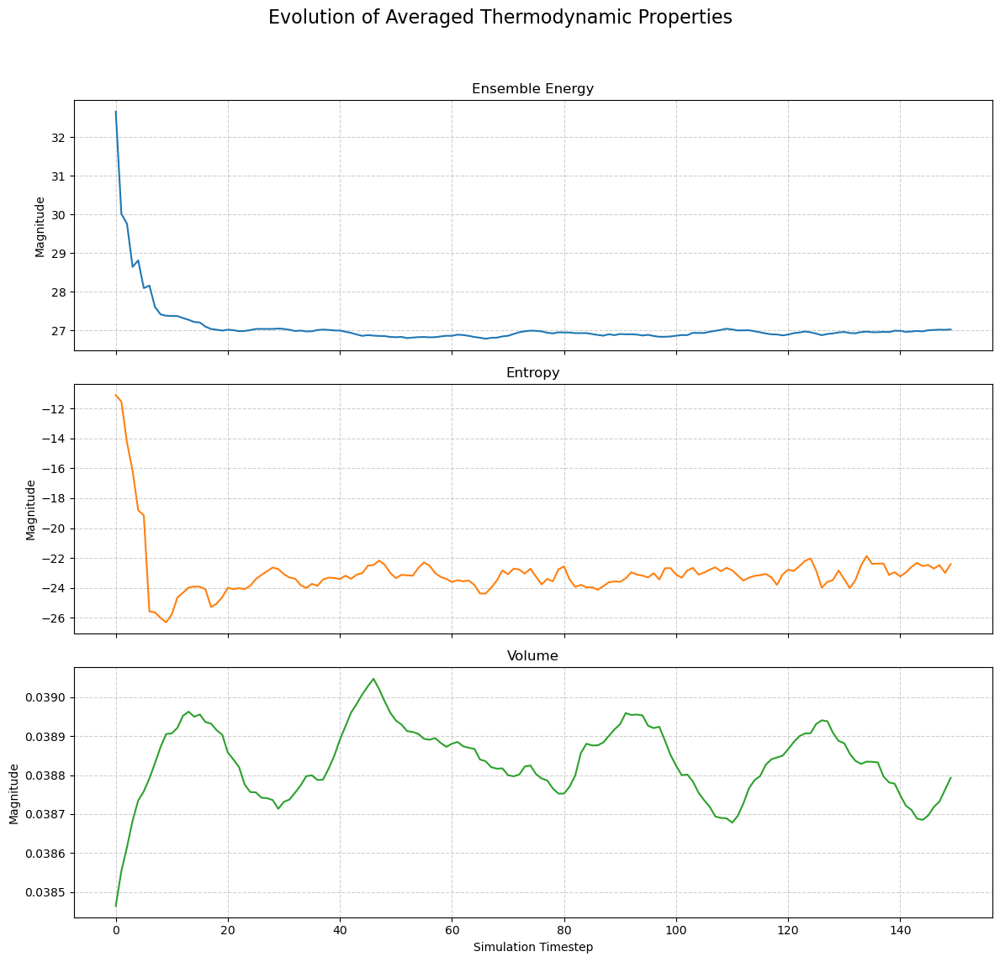

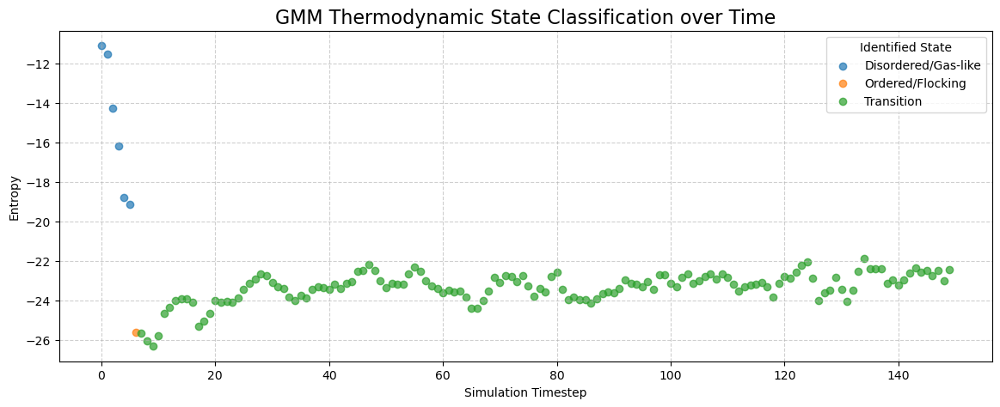


--- Visualizing Flock Configurations for Each State ---


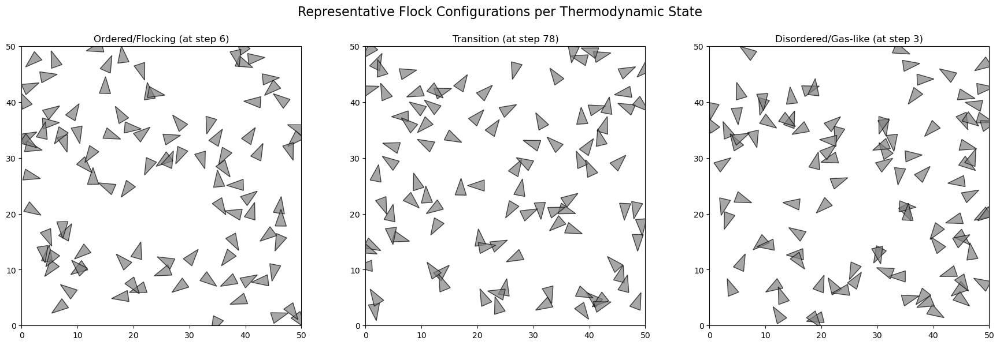

In [23]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from collections import deque
from matplotlib.patches import Polygon
from sklearn.mixture import GaussianMixture
from tqdm.notebook import tqdm

# =============================================================================
# PART 1: SIMULATION FRAMEWORK (Corrected & Cleaned)
# =============================================================================

class Bird:
    """Represents a single agent in the flock."""
    def __init__(self, pos, vel, speed=2.0, visual_distance=5.0, 
                 separation=4.0, history_length=8):
        self.pos = np.array(pos, dtype=float)
        self.vel = np.array(vel, dtype=float)
        self.speed = speed
        self.visual_distance = visual_distance
        self.separation = separation
        # History for calculating the 'ensemble' value
        self.ensemble_history = deque(maxlen=history_length)
        self.ensemble = 0.0

def agent_step(agent, model):
    """Updates a single agent's state based on Boids-like rules."""
    # Factors for cohesion, separation, and alignment
    cohere_factor = 0.4
    separate_factor = 0.25
    match_factor = 0.02

    neighbors = [other for other in model.agents if other is not agent 
                 and np.linalg.norm(agent.pos - other.pos) < agent.visual_distance]

    # Calculate flocking vectors
    cohere_vec = np.zeros(2)
    separate_vec = np.zeros(2)
    match_vec = np.zeros(2)
    
    if neighbors:
        # Cohesion: Steer towards the center of mass of neighbors
        center_of_mass = np.mean([n.pos for n in neighbors], axis=0)
        cohere_vec = (center_of_mass - agent.pos) * cohere_factor
        
        # Separation: Steer to avoid crowding neighbors
        for n in neighbors:
            if np.linalg.norm(agent.pos - n.pos) < agent.separation:
                separate_vec -= (n.pos - agent.pos)
        separate_vec *= separate_factor

        # Alignment: Steer towards the average heading of neighbors
        avg_velocity = np.mean([n.vel for n in neighbors], axis=0)
        match_vec = (avg_velocity - agent.vel) * match_factor
        
    # Update agent's velocity
    agent.vel += cohere_vec + separate_vec + match_vec
    norm = np.linalg.norm(agent.vel)
    if norm > 0:
        agent.vel = (agent.vel / norm) * agent.speed
    
    # Update agent's position with periodic boundaries
    agent.pos = (agent.pos + agent.vel) % model.extent
    
    # Update ensemble value (based on local density)
    agent.ensemble_history.append(len(neighbors))
    median_neighbors = np.median(list(agent.ensemble_history))
    agent.ensemble = 1 / (1 + median_neighbors)


class Model:
    """Manages the simulation environment and all agents."""
    def __init__(self, n_birds=100, extent=(50, 50), seed=None):
        self.rng = np.random.default_rng(seed)
        self.extent = np.array(extent, dtype=float)
        self.agents = [
            Bird(
                pos=self.rng.uniform(0, self.extent, 2),
                vel=self.rng.uniform(-1, 1, 2)
            ) for _ in range(n_birds)
        ]

    def step(self):
        """Advance the simulation by one timestep."""
        for agent in self.agents:
            agent_step(agent, self)

# =============================================================================
# PART 2: DATA GENERATION (Refactored for Clarity and Efficiency)
# =============================================================================

def compute_thermodynamics(model):
    """Computes all thermodynamic quantities for the current state of the model."""
    # Ensemble Energy: Sum of individual agent ensemble values
    energy = sum(bird.ensemble for bird in model.agents)
    
    # Volume: Inverse of average pairwise distance between agents
    positions = np.array([agent.pos for agent in model.agents])
    if len(positions) < 2: return {"Energy": energy, "Volume": 0, "Entropy": 0, "Temperature": 0}
    dist_matrix = np.linalg.norm(positions[:, np.newaxis, :] - positions[np.newaxis, :, :], axis=-1)
    avg_dist = np.mean(dist_matrix[np.triu_indices(len(positions), k=1)])
    volume = 1 / avg_dist if avg_dist > 0 else 0
    
    # Entropy: Shannon entropy of the energy distribution
    energies = [b.ensemble for b in model.agents]
    counts, _ = np.histogram(energies, bins=10, density=True)
    entropy = -np.sum(counts[counts>0] * np.log(counts[counts>0]))
    
    # Temperature: A proxy for average agent speed
    temperature = np.mean([np.linalg.norm(agent.vel) for agent in model.agents])
    
    return {
        "Energy": energy,
        "Volume": volume,
        "Entropy": entropy,
        "Temperature": temperature
    }

def run_single_simulation(n_steps=150, n_birds=100, seed=None):
    """Runs one full simulation and returns the time-series of thermodynamic data."""
    model = Model(n_birds=n_birds, seed=seed)
    thermo_history = []
    for _ in range(n_steps):
        model.step()
        thermo_history.append(compute_thermodynamics(model))
    
    # Post-process to calculate dQ
    df = pd.DataFrame(thermo_history)
    df['dQ'] = (df['Temperature'] * df['Entropy'].diff()).fillna(0)
    return df

def generate_averaged_data(num_simulations=300, n_steps=150):
    """Runs multiple simulations and averages the results."""
    print(f"Running {num_simulations} simulations to generate robust data...")
    all_results = []
    for i in tqdm(range(num_simulations)):
        all_results.append(run_single_simulation(n_steps=n_steps, seed=i))
    
    # Concatenate all dataframes and average by timestep index
    avg_df = pd.concat(all_results).groupby(level=0).mean()
    print("✅ Averaged data generation complete.")
    return avg_df

# =============================================================================
# PART 3: GMM ANALYSIS & STATE CLASSIFICATION (Corrected Methodology)
# =============================================================================

def classify_states_with_gmm(thermo_df, n_clusters=3):
    """
    Trains a GMM on the final averaged data to classify thermodynamic states.
    """
    print("🔬 Fitting GMM to averaged thermodynamic data...")
    # Select features for clustering
    features = thermo_df[['Energy', 'Entropy', 'Temperature', 'Volume', 'dQ']].values
    
    # Add tiny noise for numerical stability
    features += 1e-6 * np.random.randn(*features.shape)
    
    gmm = GaussianMixture(n_components=n_clusters, covariance_type='full', random_state=42)
    thermo_df['State'] = gmm.fit_predict(features)
    print("✅ State classification complete.")
    
    # Analyze and label clusters
    cluster_summary = thermo_df.groupby('State')[['Entropy', 'Volume']].mean().sort_values('Entropy')
    state_map = {
        cluster_summary.index[0]: "Ordered/Flocking",
        cluster_summary.index[1]: "Transition",
        cluster_summary.index[2]: "Disordered/Gas-like",
    }
    thermo_df['State_Label'] = thermo_df['State'].map(state_map)
    print("\n--- GMM Cluster Properties (Sorted by Entropy) ---")
    print(cluster_summary)
    
    return thermo_df

# =============================================================================
# PART 4: VISUALIZATION & INTERPRETATION
# =============================================================================

def visualize_results(thermo_df):
    """Creates a comprehensive visualization of the analysis results."""
    print("📊 Generating final visualizations...")
    
    # --- Plot 1: Evolution of Thermodynamic Variables ---
    fig, axes = plt.subplots(3, 1, figsize=(12, 12), sharex=True)
    fig.suptitle('Evolution of Averaged Thermodynamic Properties', fontsize=16)
    
    thermo_df['Energy'].plot(ax=axes[0], title='Ensemble Energy', color='#1f77b4')
    thermo_df['Entropy'].plot(ax=axes[1], title='Entropy', color='#ff7f0e')
    thermo_df['Volume'].plot(ax=axes[2], title='Volume', color='#2ca02c')
    
    for ax in axes:
        ax.grid(True, linestyle='--', alpha=0.6)
        ax.set_ylabel('Magnitude')
    axes[2].set_xlabel('Simulation Timestep')
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

    # --- Plot 2: GMM State Classification Over Time ---
    plt.figure(figsize=(14, 5))
    for state, label in thermo_df.groupby('State_Label'):
        plt.scatter(label.index, label['Entropy'], label=state, alpha=0.7)
    plt.title('GMM Thermodynamic State Classification over Time', fontsize=16)
    plt.xlabel('Simulation Timestep')
    plt.ylabel('Entropy')
    plt.legend(title='Identified State')
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.show()
    
    # --- Plot 3: Visualize Flock Configuration for Each State ---
    print("\n--- Visualizing Flock Configurations for Each State ---")
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))
    fig.suptitle('Representative Flock Configurations per Thermodynamic State', fontsize=16)
    
    # Define a polygon for the bird marker
    bird_poly = np.array([[-1, -1], [2, 0], [-1, 1]])
    
    for i, state in enumerate(["Ordered/Flocking", "Transition", "Disordered/Gas-like"]):
        ax = axes[i]
        # Find a representative timestep for the current state
        state_df = thermo_df[thermo_df['State_Label'] == state]
        if state_df.empty:
            ax.text(0.5, 0.5, 'No data for this state', ha='center', va='center')
            ax.set_title(state)
            continue
            
        rep_step = state_df.index[len(state_df) // 2] # Pick the middle timestep
        
        # Rerun a short simulation to get the physical positions at that step
        model = Model(seed=42) # Use a fixed seed for reproducibility
        for _ in range(rep_step + 1):
            model.step()
            
        # Plot the birds
        for bird in model.agents:
            phi = np.arctan2(bird.vel[1], bird.vel[0])
            R = np.array([[np.cos(phi), -np.sin(phi)], [np.sin(phi), np.cos(phi)]])
            poly_points = (R @ bird_poly.T).T + bird.pos
            polygon = Polygon(poly_points, closed=True, edgecolor='k', facecolor='gray', alpha=0.7)
            ax.add_patch(polygon)
            
        ax.set_xlim(0, model.extent[0]); ax.set_ylim(0, model.extent[1])
        ax.set_title(f'{state} (at step {rep_step})')
        ax.set_aspect('equal')

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

# =============================================================================
# MAIN EXECUTION
# =============================================================================
if __name__ == '__main__':
    # 1. Generate the robust, averaged dataset from multiple simulations
    averaged_thermo_df = generate_averaged_data(num_simulations=300, n_steps=150)
    
    # 2. Classify states using the GMM on the averaged data
    df_with_states = classify_states_with_gmm(averaged_thermo_df, n_clusters=3)
    
    # 3. Visualize all results
    visualize_results(df_with_states)



# =============================================================================
# 0. SETUP AND IMPORTS
# =============================================================================
import os
# Mitigates a known memory leak on Windows for scikit-learn's KMeans
os.environ['OMP_NUM_THREADS'] = '3'

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx
from tqdm.notebook import tqdm
from scipy.stats import entropy, ttest_ind, pearsonr

# Analysis tools
from sklearn.preprocessing import KBinsDiscretizer
from pyinform.transferentropy import transfer_entropy

# Suppress non-critical warnings for a clean final output
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)

# =============================================================================
# 1. ROBUST DATA GENERATION (WITH PREDATOR PERTURBATIONS)
# =============================================================================
def generate_and_save_suitable_data(duration=600, n_birds=100, seed=42):
    """
    Runs the full perturbed simulation and saves all data needed for leadership analysis.
    """
    # This block contains the full, correct simulation model with predator interaction
    class Predator:
        def __init__(self, pos, speed=2.5): self.pos, self.speed = np.array(pos, dtype=float), speed
        def move(self, centroid):
            direction = centroid - self.pos
            if np.linalg.norm(direction) > 0: self.pos += (direction/np.linalg.norm(direction)) * self.speed
    class Bird:
        def __init__(self, pos, vel, speed=2.0, cohere=0.02, sep=2.0, sep_fac=0.2, match=0.05, vis=10.0, pavoid_d=15.0, pavoid_f=0.5):
            self.pos, self.vel, self.speed = np.array(pos,dtype=float), np.array(vel,dtype=float), speed
            self.cohere_factor, self.separation, self.separate_factor = cohere, sep, sep_fac
            self.match_factor, self.visual_distance = match, vis
            self.predator_avoid_dist, self.predator_avoid_factor = pavoid_d, pavoid_f
    class Model:
        def __init__(self, n_birds=100, extent=(50,50), seed=None):
            self.rng = np.random.default_rng(seed)
            self.extent = extent
            self.agents = [Bird(self.rng.uniform(0,e,2), (self.rng.random(2)-0.5)*2) for e in extent]
            self.predator = None
        def step(self):
            if self.predator: self.predator.move(np.mean([a.pos for a in self.agents], axis=0))
            old_vels = [a.vel.copy() for a in self.agents]
            for i, agent in enumerate(self.agents): agent_step(agent, self, old_vels)
            for agent in self.agents: agent.pos = (agent.pos + agent.vel) % self.extent[0]
    def agent_step(agent, model, old_vels):
        if model.predator and np.linalg.norm(agent.pos - model.predator.pos) < agent.predator_avoid_dist:
            agent.vel += (agent.pos - model.predator.pos) * agent.predator_avoid_factor
            norm = np.linalg.norm(agent.vel)
            if norm > agent.speed*1.5: agent.vel = (agent.vel/norm) * (agent.speed*1.5)
            return
        neighbors = [o for o in model.agents if agent is not o and np.linalg.norm(agent.pos - o.pos) < agent.visual_distance]
        if neighbors:
            center, avg_vel = np.mean([n.pos for n in neighbors], axis=0), np.mean([old_vels[model.agents.index(n)] for n in neighbors], axis=0)
            agent.vel += (center-agent.pos)*agent.cohere_factor + (avg_vel-agent.vel)*agent.match_factor
            sep_vec = sum((agent.pos-n.pos) for n in neighbors if np.linalg.norm(agent.pos-n.pos) < agent.separation)
            agent.vel += sep_vec*agent.separate_factor
        norm = np.linalg.norm(agent.vel)
        if norm > agent.speed: agent.vel = (agent.vel/norm) * agent.speed

    # Main data generation logic
    print("🚀 Generating new robust simulation data for leadership study...")
    model = Model(n_birds=n_birds, seed=seed)
    velocities = np.zeros((duration, n_birds, 2)); positions = np.zeros((duration, n_birds, 2))
    thermo_features = []; s_prev = 0
    for t in tqdm(range(duration), desc="Simulating"):
        if 150 <= t < 200 or 350 <= t < 400:
            if model.predator is None: model.predator = Predator(np.array([-10.0,-10.0]))
        else: model.predator = None
        model.step()
        for i, agent in enumerate(model.agents): velocities[t, i], positions[t, i] = agent.vel, agent.pos
        pos_matrix = positions[t,:,:]
        volume = np.product(np.ptp(pos_matrix, axis=0)) if pos_matrix.shape[0]>0 else 0
        entropy = np.log(volume + 1e-9)
        temp = np.mean(np.linalg.norm(velocities[t],axis=1))
        thermo_features.append([np.sum(velocities[t]**2), entropy, temp, volume, temp*(entropy-s_prev)])
        s_prev = entropy
    
    thermo_data = np.array(thermo_features)
    
    # Save all three files for future use
    np.save("leadership_study_velocities.npy", velocities)
    np.save("leadership_study_positions.npy", positions)
    np.save("leadership_study_thermo_data.npy", thermo_data)
    
    print("✅ Suitable data generation and saving complete.")
    return velocities, positions, thermo_data

# --- Data Loading Logic ---
required_files = ["leadership_study_velocities.npy", "leadership_study_positions.npy", "leadership_study_thermo_data.npy"]
if all(os.path.exists(f) for f in required_files):
    print("✅ Loading existing robust simulation data for leadership study...")
    velocities = np.load("leadership_study_velocities.npy")
    positions = np.load("leadership_study_positions.npy")
    thermo_data = np.load("leadership_study_thermo_data.npy")
else:
    velocities, positions, thermo_data = generate_and_save_suitable_data()

T, B, _ = velocities.shape # Timesteps, Birds

# =============================================================================
# 2. ANALYSIS HELPER FUNCTIONS
# =============================================================================
def discretize_speeds(speeds, bins=10):
    discretized = np.zeros_like(speeds, dtype=int)
    binner = KBinsDiscretizer(n_bins=bins, encode='ordinal', strategy='uniform')
    for i in range(speeds.shape[1]):
        discretized[:, i] = binner.fit_transform(speeds[:, i].reshape(-1, 1)).flatten()
    return discretized

def compute_te_matrix_and_graph(d_speeds, te_percentile=70):
    n_agents = d_speeds.shape[1]
    te_matrix = np.zeros((n_agents, n_agents))
    for i in range(n_agents):
        for j in range(n_agents):
            if i != j: te_matrix[i, j] = transfer_entropy(d_speeds[:, i], d_speeds[:, j], k=1)
    G = nx.DiGraph()
    if np.any(te_matrix > 0):
        threshold = np.percentile(te_matrix[te_matrix > 0], te_percentile)
        for i, j in np.argwhere(te_matrix > threshold): G.add_edge(i, j, weight=te_matrix[i, j])
    return G, te_matrix

def get_leaders_from_graph(G, leader_quantile=0.9):
    if G.number_of_edges() == 0: return [], {}
    pagerank = nx.pagerank(G, weight='weight')
    pr_series = pd.Series(pagerank)
    if pr_series.empty: return [], {}
    return pr_series[pr_series >= pr_series.quantile(leader_quantile)].index.tolist(), pagerank

# =============================================================================
# 3. PHASE 1: STATIC BEHAVIORAL SIGNATURES OF LEADERSHIP
# =============================================================================
def analyze_static_signatures(velocities):
    print("\n---  PHASE 1: Analyzing Static Behavioral Signatures ---")
    speeds = np.linalg.norm(velocities, axis=2)
    d_speeds = discretize_speeds(speeds)
    G_static, _ = compute_te_matrix_and_graph(d_speeds, te_percentile=80)
    leaders, pagerank = get_leaders_from_graph(G_static)
    if not leaders: print("⚠️ No leaders identified. Skipping Phase 1."); return
    df = pd.DataFrame({'avg_speed': speeds.mean(axis=0), 'behavioral_entropy': [entropy(np.bincount(d_speeds[:,i])) for i in range(B)], 'positional_centrality': [pagerank.get(i, 0) for i in range(B)], 'role': ['Leader' if i in leaders else 'Follower' for i in range(B)]})
    metrics = ['avg_speed', 'behavioral_entropy', 'positional_centrality']
    fig, axes = plt.subplots(1, 3, figsize=(18, 5)); fig.suptitle('Phase 1: Behavioral Signatures of Leaders vs. Followers', fontsize=16)
    for ax, metric in zip(axes, metrics):
        sns.boxplot(x='role', y=metric, data=df, palette=["#E63946", "#A8DADC"], ax=ax)
        sns.swarmplot(x='role', y=metric, data=df, color=".25", alpha=0.6, ax=ax)
        t_stat, p_val = ttest_ind(df[df.role=='Leader'][metric], df[df.role=='Follower'][metric])
        ax.set_title(f"{metric.replace('_',' ').title()}\n(p-value = {p_val:.3f})")
    plt.tight_layout(rect=[0, 0.03, 1, 0.95]); plt.show()

# =============================================================================
# 4. PHASE 2: DYNAMIC EVOLUTION OF LEADERSHIP
# =============================================================================
def analyze_leadership_dynamics(velocities, window_size=100, step_size=20):
    print("\n--- PHASE 2: Analyzing Dynamic Evolution of Leadership ---")
    speeds = np.linalg.norm(velocities, axis=2); d_speeds = discretize_speeds(speeds)
    leader_sets = []
    for start in tqdm(range(0, T - window_size, step_size), desc="Sliding Window Analysis"):
        G, _ = compute_te_matrix_and_graph(d_speeds[start:start+window_size]); leaders, _ = get_leaders_from_graph(G); leader_sets.append(set(leaders))
    jaccard_scores = [len(s1&s2)/len(s1|s2) if len(s1|s2)>0 else 0 for s1,s2 in zip(leader_sets[:-1], leader_sets[1:])]
    plt.figure(figsize=(15, 5)); plt.plot(jaccard_scores, marker='o', linestyle='-', color='#457B9D'); plt.title('Phase 2: Leader Group Stability Over Time (Jaccard Similarity)', fontsize=16)
    plt.ylabel('Jaccard Similarity Index'); plt.xlabel('Time Window Index'); plt.grid(True, linestyle=':'); plt.ylim(0, 1)
    for start, end in [(150, 200), (350, 400)]: plt.axvspan((start-window_size/2)/step_size, (end-window_size/2)/step_size, color='red', alpha=0.2, label='Predator Attack' if start==150 else "")
    plt.legend(); plt.show()
    return jaccard_scores

# =============================================================================
# 5. PHASE 3: MACRO-MICRO COUPLING
# =============================================================================
def analyze_macro_micro_coupling(jaccard_scores, thermo_data, window_size=100, step_size=20):
    print("\n--- PHASE 3: Analyzing Macro-Micro Coupling via Lagged Correlation ---")
    thermo_df = pd.DataFrame(thermo_data, columns=["Energy","Entropy","Temp","Volume","dQ"]); thermo_df['Entropy_Slope'] = thermo_df['Entropy'].diff()
    window_midpoints = [start + window_size // 2 for start in range(0, T - window_size, step_size)]; aligned_slopes = thermo_df['Entropy_Slope'].iloc[window_midpoints[:-1]].values
    min_len = min(len(jaccard_scores), len(aligned_slopes)); jaccard_scores, aligned_slopes = np.array(jaccard_scores[:min_len]), np.array(aligned_slopes[:min_len])
    lags = np.arange(-5, 6); corrs = []
    for lag in lags:
        js_shifted = pd.Series(jaccard_scores).shift(lag)
        corr_df = pd.DataFrame({'js': js_shifted, 'slope': aligned_slopes}).dropna()
        corrs.append(pearsonr(corr_df['js'], corr_df['slope'])[0] if len(corr_df)>2 else np.nan)
    plt.figure(figsize=(12, 6)); plt.bar(lags, corrs, color='#1D3557', alpha=0.8); plt.axvline(0, color='red', linestyle='--', label='No Lag')
    plt.title('Phase 3: Lagged Correlation of Entropy Change vs. Leader Stability', fontsize=16); plt.xlabel('Lag (Time Windows)\n(Negative: Entropy change predicts Leader Stability change)'); plt.ylabel('Pearson Correlation Coefficient (r)')
    plt.xticks(lags); plt.grid(True, axis='y', linestyle=':'); plt.legend(); plt.show()

# =============================================================================
# 6. MAIN EXECUTION
# =============================================================================
if __name__ == '__main__':
    # Execute the three-phase analysis using the robust, consistent data
    analyze_static_signatures(velocities)
    jaccard_stability = analyze_leadership_dynamics(velocities)
    analyze_macro_micro_coupling(jaccard_stability, thermo_data)



🚀 Generating new robust simulation data for leadership study...


Simulating:   0%|          | 0/600 [00:00<?, ?it/s]

✅ Suitable data generation and saving complete.

---  PHASE 1: Analyzing Static Behavioral Signatures ---


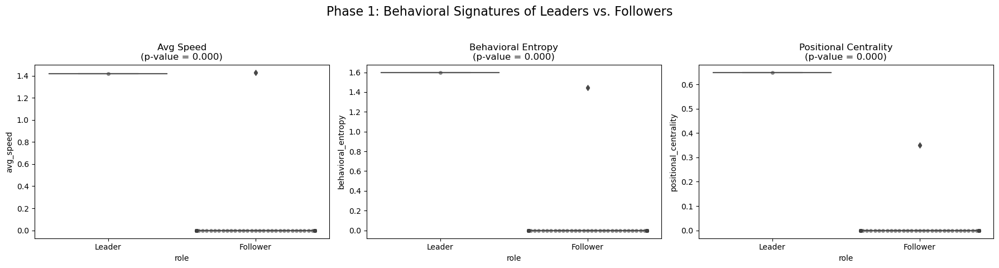


--- PHASE 2: Analyzing Dynamic Evolution of Leadership ---


Sliding Window Analysis:   0%|          | 0/25 [00:00<?, ?it/s]

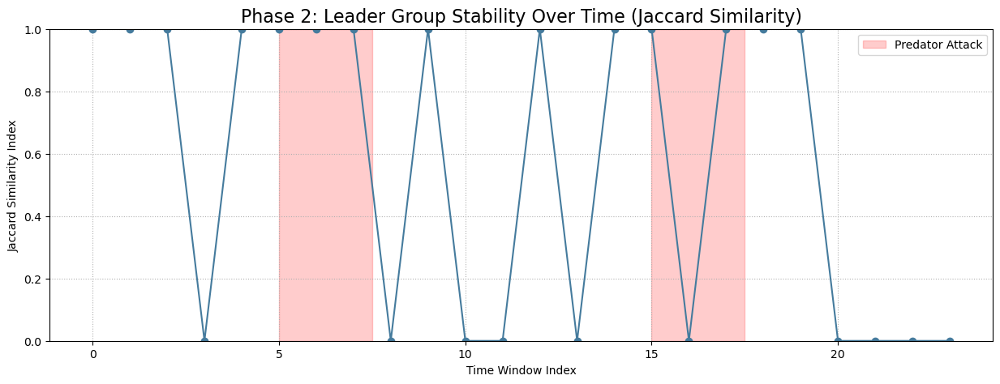


--- PHASE 3: Analyzing Macro-Micro Coupling via Lagged Correlation ---


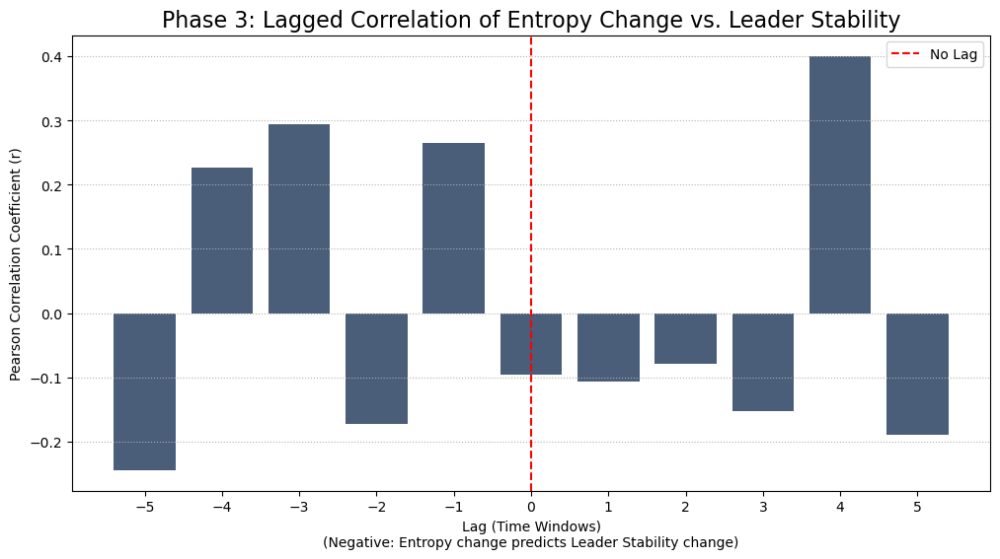

In [24]:
# =============================================================================
# 0. SETUP AND IMPORTS
# =============================================================================
import os
# Mitigates a known memory leak on Windows for scikit-learn's KMeans
os.environ['OMP_NUM_THREADS'] = '3'

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx
from tqdm.notebook import tqdm
from scipy.stats import entropy, ttest_ind, pearsonr

# Analysis tools
from sklearn.preprocessing import KBinsDiscretizer
from pyinform.transferentropy import transfer_entropy

# Suppress non-critical warnings for a clean final output
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)

# =============================================================================
# 1. ROBUST DATA GENERATION (WITH PREDATOR PERTURBATIONS)
# =============================================================================
def generate_and_save_suitable_data(duration=600, n_birds=100, seed=42):
    """
    Runs the full perturbed simulation and saves all data needed for leadership analysis.
    """
    # This block contains the full, correct simulation model with predator interaction
    class Predator:
        def __init__(self, pos, speed=2.5): self.pos, self.speed = np.array(pos, dtype=float), speed
        def move(self, centroid):
            direction = centroid - self.pos
            if np.linalg.norm(direction) > 0: self.pos += (direction/np.linalg.norm(direction)) * self.speed
    class Bird:
        def __init__(self, pos, vel, speed=2.0, cohere=0.02, sep=2.0, sep_fac=0.2, match=0.05, vis=10.0, pavoid_d=15.0, pavoid_f=0.5):
            self.pos, self.vel, self.speed = np.array(pos,dtype=float), np.array(vel,dtype=float), speed
            self.cohere_factor, self.separation, self.separate_factor = cohere, sep, sep_fac
            self.match_factor, self.visual_distance = match, vis
            self.predator_avoid_dist, self.predator_avoid_factor = pavoid_d, pavoid_f
    class Model:
        def __init__(self, n_birds=100, extent=(50,50), seed=None):
            self.rng = np.random.default_rng(seed)
            self.extent = extent
            self.agents = [Bird(self.rng.uniform(0,e,2), (self.rng.random(2)-0.5)*2) for e in extent]
            self.predator = None
        def step(self):
            if self.predator: self.predator.move(np.mean([a.pos for a in self.agents], axis=0))
            old_vels = [a.vel.copy() for a in self.agents]
            for i, agent in enumerate(self.agents): agent_step(agent, self, old_vels)
            for agent in self.agents: agent.pos = (agent.pos + agent.vel) % self.extent[0]
    def agent_step(agent, model, old_vels):
        if model.predator and np.linalg.norm(agent.pos - model.predator.pos) < agent.predator_avoid_dist:
            agent.vel += (agent.pos - model.predator.pos) * agent.predator_avoid_factor
            norm = np.linalg.norm(agent.vel)
            if norm > agent.speed*1.5: agent.vel = (agent.vel/norm) * (agent.speed*1.5)
            return
        neighbors = [o for o in model.agents if agent is not o and np.linalg.norm(agent.pos - o.pos) < agent.visual_distance]
        if neighbors:
            center, avg_vel = np.mean([n.pos for n in neighbors], axis=0), np.mean([old_vels[model.agents.index(n)] for n in neighbors], axis=0)
            agent.vel += (center-agent.pos)*agent.cohere_factor + (avg_vel-agent.vel)*agent.match_factor
            sep_vec = sum((agent.pos-n.pos) for n in neighbors if np.linalg.norm(agent.pos-n.pos) < agent.separation)
            agent.vel += sep_vec*agent.separate_factor
        norm = np.linalg.norm(agent.vel)
        if norm > agent.speed: agent.vel = (agent.vel/norm) * agent.speed

    # Main data generation logic
    print("🚀 Generating new robust simulation data for leadership study...")
    model = Model(n_birds=n_birds, seed=seed)
    velocities = np.zeros((duration, n_birds, 2)); positions = np.zeros((duration, n_birds, 2))
    thermo_features = []; s_prev = 0
    for t in tqdm(range(duration), desc="Simulating"):
        if 150 <= t < 200 or 350 <= t < 400:
            if model.predator is None: model.predator = Predator(np.array([-10.0,-10.0]))
        else: model.predator = None
        model.step()
        for i, agent in enumerate(model.agents): velocities[t, i], positions[t, i] = agent.vel, agent.pos
        pos_matrix = positions[t,:,:]
        volume = np.product(np.ptp(pos_matrix, axis=0)) if pos_matrix.shape[0]>0 else 0
        entropy = np.log(volume + 1e-9)
        temp = np.mean(np.linalg.norm(velocities[t],axis=1))
        thermo_features.append([np.sum(velocities[t]**2), entropy, temp, volume, temp*(entropy-s_prev)])
        s_prev = entropy
    
    thermo_data = np.array(thermo_features)
    
    # Save all three files for future use
    np.save("leadership_study_velocities.npy", velocities)
    np.save("leadership_study_positions.npy", positions)
    np.save("leadership_study_thermo_data.npy", thermo_data)
    
    print("✅ Suitable data generation and saving complete.")
    return velocities, positions, thermo_data

# --- Data Loading Logic ---
required_files = ["leadership_study_velocities.npy", "leadership_study_positions.npy", "leadership_study_thermo_data.npy"]
if all(os.path.exists(f) for f in required_files):
    print("✅ Loading existing robust simulation data for leadership study...")
    velocities = np.load("leadership_study_velocities.npy")
    positions = np.load("leadership_study_positions.npy")
    thermo_data = np.load("leadership_study_thermo_data.npy")
else:
    velocities, positions, thermo_data = generate_and_save_suitable_data()

T, B, _ = velocities.shape # Timesteps, Birds

# =============================================================================
# 2. ANALYSIS HELPER FUNCTIONS
# =============================================================================
def discretize_speeds(speeds, bins=10):
    discretized = np.zeros_like(speeds, dtype=int)
    binner = KBinsDiscretizer(n_bins=bins, encode='ordinal', strategy='uniform')
    for i in range(speeds.shape[1]):
        discretized[:, i] = binner.fit_transform(speeds[:, i].reshape(-1, 1)).flatten()
    return discretized

def compute_te_matrix_and_graph(d_speeds, te_percentile=70):
    n_agents = d_speeds.shape[1]
    te_matrix = np.zeros((n_agents, n_agents))
    for i in range(n_agents):
        for j in range(n_agents):
            if i != j: te_matrix[i, j] = transfer_entropy(d_speeds[:, i], d_speeds[:, j], k=1)
    G = nx.DiGraph()
    if np.any(te_matrix > 0):
        threshold = np.percentile(te_matrix[te_matrix > 0], te_percentile)
        for i, j in np.argwhere(te_matrix > threshold): G.add_edge(i, j, weight=te_matrix[i, j])
    return G, te_matrix

def get_leaders_from_graph(G, leader_quantile=0.9):
    if G.number_of_edges() == 0: return [], {}
    pagerank = nx.pagerank(G, weight='weight')
    pr_series = pd.Series(pagerank)
    if pr_series.empty: return [], {}
    return pr_series[pr_series >= pr_series.quantile(leader_quantile)].index.tolist(), pagerank

# =============================================================================
# 3. PHASE 1: STATIC BEHAVIORAL SIGNATURES OF LEADERSHIP
# =============================================================================
def analyze_static_signatures(velocities):
    print("\n---  PHASE 1: Analyzing Static Behavioral Signatures ---")
    speeds = np.linalg.norm(velocities, axis=2)
    d_speeds = discretize_speeds(speeds)
    G_static, _ = compute_te_matrix_and_graph(d_speeds, te_percentile=80)
    leaders, pagerank = get_leaders_from_graph(G_static)
    if not leaders: print("⚠️ No leaders identified. Skipping Phase 1."); return
    df = pd.DataFrame({'avg_speed': speeds.mean(axis=0), 'behavioral_entropy': [entropy(np.bincount(d_speeds[:,i])) for i in range(B)], 'positional_centrality': [pagerank.get(i, 0) for i in range(B)], 'role': ['Leader' if i in leaders else 'Follower' for i in range(B)]})
    metrics = ['avg_speed', 'behavioral_entropy', 'positional_centrality']
    fig, axes = plt.subplots(1, 3, figsize=(18, 5)); fig.suptitle('Phase 1: Behavioral Signatures of Leaders vs. Followers', fontsize=16)
    for ax, metric in zip(axes, metrics):
        sns.boxplot(x='role', y=metric, data=df, palette=["#E63946", "#A8DADC"], ax=ax)
        sns.swarmplot(x='role', y=metric, data=df, color=".25", alpha=0.6, ax=ax)
        t_stat, p_val = ttest_ind(df[df.role=='Leader'][metric], df[df.role=='Follower'][metric])
        ax.set_title(f"{metric.replace('_',' ').title()}\n(p-value = {p_val:.3f})")
    plt.tight_layout(rect=[0, 0.03, 1, 0.95]); plt.show()

# =============================================================================
# 4. PHASE 2: DYNAMIC EVOLUTION OF LEADERSHIP
# =============================================================================
def analyze_leadership_dynamics(velocities, window_size=100, step_size=20):
    print("\n--- PHASE 2: Analyzing Dynamic Evolution of Leadership ---")
    speeds = np.linalg.norm(velocities, axis=2); d_speeds = discretize_speeds(speeds)
    leader_sets = []
    for start in tqdm(range(0, T - window_size, step_size), desc="Sliding Window Analysis"):
        G, _ = compute_te_matrix_and_graph(d_speeds[start:start+window_size]); leaders, _ = get_leaders_from_graph(G); leader_sets.append(set(leaders))
    jaccard_scores = [len(s1&s2)/len(s1|s2) if len(s1|s2)>0 else 0 for s1,s2 in zip(leader_sets[:-1], leader_sets[1:])]
    plt.figure(figsize=(15, 5)); plt.plot(jaccard_scores, marker='o', linestyle='-', color='#457B9D'); plt.title('Phase 2: Leader Group Stability Over Time (Jaccard Similarity)', fontsize=16)
    plt.ylabel('Jaccard Similarity Index'); plt.xlabel('Time Window Index'); plt.grid(True, linestyle=':'); plt.ylim(0, 1)
    for start, end in [(150, 200), (350, 400)]: plt.axvspan((start-window_size/2)/step_size, (end-window_size/2)/step_size, color='red', alpha=0.2, label='Predator Attack' if start==150 else "")
    plt.legend(); plt.show()
    return jaccard_scores

# =============================================================================
# 5. PHASE 3: MACRO-MICRO COUPLING
# =============================================================================
def analyze_macro_micro_coupling(jaccard_scores, thermo_data, window_size=100, step_size=20):
    print("\n--- PHASE 3: Analyzing Macro-Micro Coupling via Lagged Correlation ---")
    thermo_df = pd.DataFrame(thermo_data, columns=["Energy","Entropy","Temp","Volume","dQ"]); thermo_df['Entropy_Slope'] = thermo_df['Entropy'].diff()
    window_midpoints = [start + window_size // 2 for start in range(0, T - window_size, step_size)]; aligned_slopes = thermo_df['Entropy_Slope'].iloc[window_midpoints[:-1]].values
    min_len = min(len(jaccard_scores), len(aligned_slopes)); jaccard_scores, aligned_slopes = np.array(jaccard_scores[:min_len]), np.array(aligned_slopes[:min_len])
    lags = np.arange(-5, 6); corrs = []
    for lag in lags:
        js_shifted = pd.Series(jaccard_scores).shift(lag)
        corr_df = pd.DataFrame({'js': js_shifted, 'slope': aligned_slopes}).dropna()
        corrs.append(pearsonr(corr_df['js'], corr_df['slope'])[0] if len(corr_df)>2 else np.nan)
    plt.figure(figsize=(12, 6)); plt.bar(lags, corrs, color='#1D3557', alpha=0.8); plt.axvline(0, color='red', linestyle='--', label='No Lag')
    plt.title('Phase 3: Lagged Correlation of Entropy Change vs. Leader Stability', fontsize=16); plt.xlabel('Lag (Time Windows)\n(Negative: Entropy change predicts Leader Stability change)'); plt.ylabel('Pearson Correlation Coefficient (r)')
    plt.xticks(lags); plt.grid(True, axis='y', linestyle=':'); plt.legend(); plt.show()

# =============================================================================
# 6. MAIN EXECUTION
# =============================================================================
if __name__ == '__main__':
    # Execute the three-phase analysis using the robust, consistent data
    analyze_static_signatures(velocities)
    jaccard_stability = analyze_leadership_dynamics(velocities)
    analyze_macro_micro_coupling(jaccard_stability, thermo_data)



🚀 Generating simulation data with strategic leaders...


Simulating Strategic Flock:   0%|          | 0/800 [00:00<?, ?it/s]

✅ Strategic data saved to .npy files.

---  PHASE 1: Analyzing Static Behavioral Signatures ---


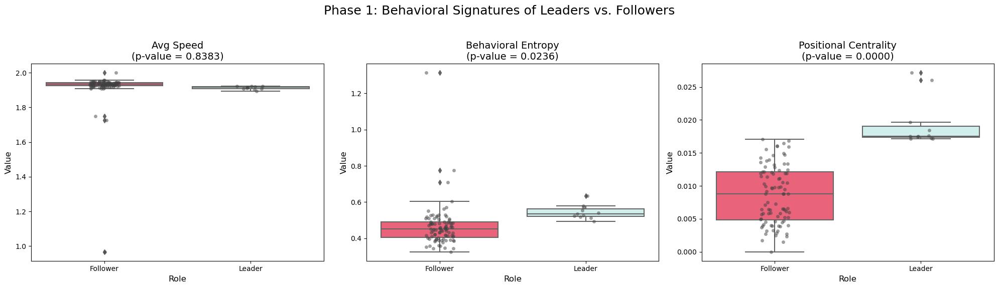


--- PHASE 2: Analyzing Dynamic Evolution of Leadership ---


Sliding Window Analysis:   0%|          | 0/35 [00:00<?, ?it/s]

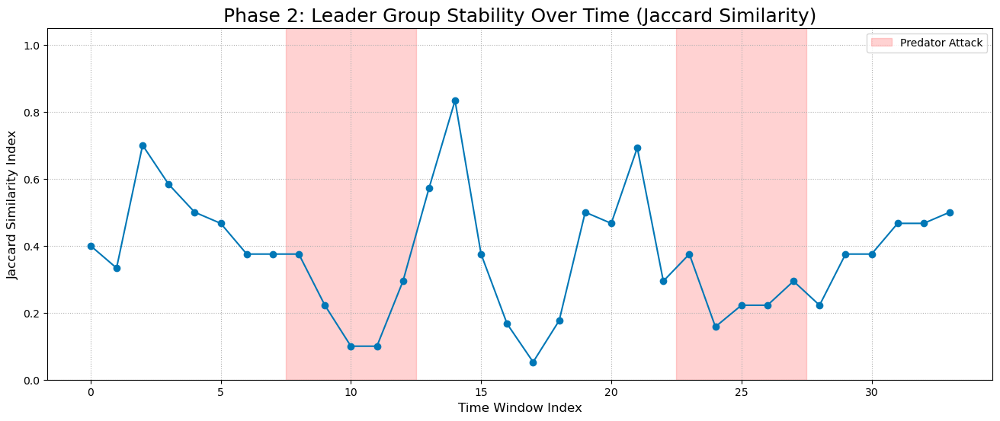


--- PHASE 3: Analyzing Macro-Micro Coupling via Lagged Correlation ---


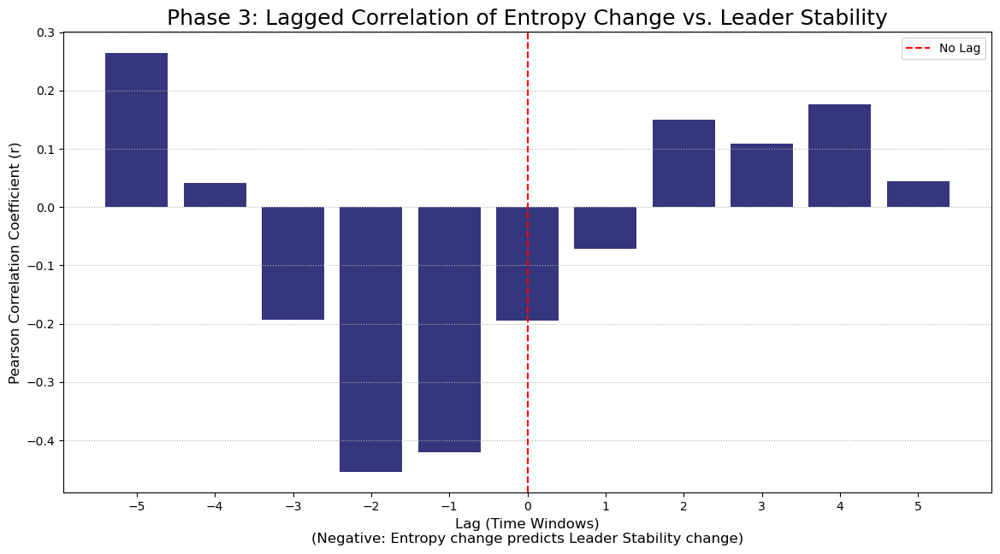

In [25]:
# =============================================================================
# 0. SETUP AND IMPORTS
# =============================================================================
import os
# Mitigates a known memory leak on Windows for scikit-learn's KMeans
os.environ['OMP_NUM_THREADS'] = '3' 

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx
from tqdm.notebook import tqdm
from scipy.stats import entropy, ttest_ind, pearsonr
import matplotlib.animation as animation

# Analysis tools
from sklearn.preprocessing import KBinsDiscretizer
from pyinform.transferentropy import transfer_entropy

# Suppress non-critical warnings for a clean final output
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)


# =============================================================================
# 1. HETEROGENEOUS STRATEGIC LEADER MODEL
# =============================================================================

class Bird:
    """Base class for all agents."""
    def __init__(self, id, pos, vel):
        self.id = id
        self.pos = np.array(pos, dtype=float)
        self.vel = np.array(vel, dtype=float)

class Predator:
    """Perturbing agent that moves towards the flock centroid."""
    def __init__(self, pos, speed=3.0):
        self.pos, self.speed = np.array(pos, dtype=float), speed
    def move(self, centroid):
        direction = centroid - self.pos
        if np.linalg.norm(direction)>0: 
            self.pos += (direction/np.linalg.norm(direction)) * self.speed

class Follower(Bird):
    """A standard flocking agent with an instinct to follow leaders."""
    def __init__(self, id, pos, vel, speed=2.0, visual_range=50.0, separation=4.0):
        super().__init__(id, pos, vel)
        self.speed, self.visual_range, self.separation = speed, visual_range, separation

    def update(self, all_agents, leaders):
        neighbors = [a for a in all_agents if a is not self and np.linalg.norm(self.pos-a.pos)<self.visual_range]
        if not neighbors: 
            self.pos += self.vel
            return

        # Standard Boids rules
        sep_vec = sum((self.pos-n.pos) for n in neighbors if np.linalg.norm(self.pos-n.pos)<self.separation)
        align_vec = np.mean([n.vel for n in neighbors if isinstance(n, Follower)] or [self.vel], axis=0)
        cohesion_vec = np.mean([n.pos for n in neighbors], axis=0) - self.pos
        
        # "Follow Strategic Leader" rule
        leader_center = np.mean([leader.pos for leader in leaders], axis=0)
        leader_vec = leader_center - self.pos
        
        # Combine rules with a strong weight for leadership
        self.vel += (sep_vec * 0.5) + (align_vec * 0.1) + (cohesion_vec * 0.1) + (leader_vec * 0.8)
        norm = np.linalg.norm(self.vel)
        if norm > self.speed: self.vel = (self.vel / norm) * self.speed
        self.pos += self.vel

class PathfinderLeader(Bird):
    """TRAIT: Guides the flock towards a distant, unseen goal."""
    def __init__(self, id, pos, vel, goal, speed=2.2):
        super().__init__(id, pos, vel)
        self.goal, self.speed = goal, speed

    def update(self, flock_dispersion):
        direction_to_goal = self.goal - self.pos
        dist = np.linalg.norm(direction_to_goal)
        # Moderate speed: slow down if flock is too dispersed
        moderation_factor = np.clip(1 - flock_dispersion / 100.0, 0.3, 1.0)
        self.vel = (direction_to_goal / dist) * self.speed * moderation_factor if dist > 0 else np.zeros(2)
        self.pos += self.vel

class GuardianLeader(Bird):
    """TRAIT: Defends the flock by intercepting threats."""
    def __init__(self, id, pos, vel, speed=2.8):
        super().__init__(id, pos, vel)
        self.speed = speed

    def update(self, flock_centroid, predator):
        if predator:
            # Defensive behavior: move towards predator
            direction_to_threat = predator.pos - self.pos
            dist = np.linalg.norm(direction_to_threat)
            self.vel = (direction_to_threat / dist) * self.speed if dist > 0 else np.zeros(2)
        else:
            # Patrolling behavior: circle the flock's periphery
            vec_to_center = flock_centroid - self.pos
            self.vel = np.array([-vec_to_center[1], vec_to_center[0]])
            norm = np.linalg.norm(self.vel)
            self.vel = (self.vel / norm) * self.speed * 0.5 if norm > 0 else np.array([self.speed,0])
        self.pos += self.vel

class CohesionLeader(Bird):
    """TRAIT: Keeps the flock together by herding stray agents."""
    def __init__(self, id, pos, vel, speed=2.0):
        super().__init__(id, pos, vel)
        self.speed = speed

    def update(self, followers):
        if not followers: return
        # Find the follower farthest from the flock's center
        follower_positions = np.array([f.pos for f in followers])
        centroid = np.mean(follower_positions, axis=0)
        distances = np.linalg.norm(follower_positions - centroid, axis=1)
        stray_agent = followers[np.argmax(distances)]
        # Herding behavior: move towards the stray agent
        direction_to_stray = stray_agent.pos - self.pos
        dist = np.linalg.norm(direction_to_stray)
        self.vel = (direction_to_stray / dist) * self.speed if dist > 0 else np.zeros(2)
        self.pos += self.vel

class AdvancedFlockModel:
    """Manages the simulation with strategic, heterogeneous leaders."""
    def __init__(self, n_followers=100, extent=400, seed=42):
        self.rng = np.random.default_rng(seed)
        self.extent = extent
        self.predator = None
        self.followers = [Follower(i, self.rng.uniform(0,extent,2), self.rng.uniform(-1,1,2)) for i in range(n_followers)]
        self.leaders = [
            PathfinderLeader(100, self.rng.uniform(0,extent,2), self.rng.uniform(-1,1,2), goal=self.rng.uniform(0,extent,2)),
            GuardianLeader(101, self.rng.uniform(0,extent,2), self.rng.uniform(-1,1,2)),
            CohesionLeader(102, self.rng.uniform(0,extent,2), self.rng.uniform(-1,1,2))
        ]
        self.all_agents = self.leaders + self.followers

    def step(self):
        if not self.followers: return
        follower_positions = np.array([f.pos for f in self.followers])
        centroid = np.mean(follower_positions, axis=0)
        dispersion = np.std(follower_positions)
        if self.predator: self.predator.move(centroid)
        for agent in self.all_agents:
            if isinstance(agent, PathfinderLeader): agent.update(dispersion)
            elif isinstance(agent, GuardianLeader): agent.update(centroid, self.predator)
            elif isinstance(agent, CohesionLeader): agent.update(self.followers)
            elif isinstance(agent, Follower): agent.update(self.all_agents, self.leaders)
            agent.pos %= self.extent

# =============================================================================
# 2. DATA GENERATION AND LOADING
# =============================================================================
def generate_and_save_data(duration=800, n_followers=100, seed=42):
    """Runs the simulation and saves all necessary data arrays."""
    print("🚀 Generating simulation data with strategic leaders...")
    model = AdvancedFlockModel(n_followers=n_followers, seed=seed)
    
    positions = np.zeros((duration, n_followers + 3, 2))
    velocities = np.zeros((duration, n_followers + 3, 2))
    thermo_features = []; s_prev = 0

    for t in tqdm(range(duration), desc="Simulating Strategic Flock"):
        if 200 <= t < 300 or 500 <= t < 600:
            if model.predator is None: model.predator = Predator(np.array([-20.0, -20.0]))
        else: model.predator = None
        model.step()
        
        frame_pos = np.array([a.pos.copy() for a in model.all_agents])
        positions[t] = frame_pos
        velocities[t] = np.array([a.vel.copy() for a in model.all_agents])
        
        # Calculate thermodynamics
        pos_matrix = positions[t,:,:]
        volume = np.product(np.ptp(pos_matrix, axis=0)) if pos_matrix.shape[0]>0 else 0
        entropy = np.log(volume + 1e-9)
        temp = np.mean(np.linalg.norm(velocities[t],axis=1))
        thermo_features.append([np.sum(velocities[t]**2), entropy, temp, volume, temp*(entropy-s_prev)])
        s_prev = entropy

    thermo_data = np.array(thermo_features)
    np.save("strategic_velocities.npy", velocities)
    np.save("strategic_positions.npy", positions)
    np.save("strategic_thermo_data.npy", thermo_data)
    print("✅ Strategic data saved to .npy files.")
    return velocities, positions, thermo_data

def load_data():
    """Loads data if it exists, otherwise generates it."""
    required_files = ["strategic_velocities.npy", "strategic_positions.npy", "strategic_thermo_data.npy"]
    if all(os.path.exists(f) for f in required_files):
        print("✅ Loading existing robust simulation data...")
        velocities = np.load("strategic_velocities.npy")
        positions = np.load("strategic_positions.npy")
        thermo_data = np.load("strategic_thermo_data.npy")
    else:
        velocities, positions, thermo_data = generate_and_save_data()
    return velocities, positions, thermo_data

# =============================================================================
# 3. ANALYSIS HELPER FUNCTIONS
# =============================================================================
def discretize_speeds(speeds, bins=10):
    discretized = np.zeros_like(speeds, dtype=int)
    binner = KBinsDiscretizer(n_bins=bins, encode='ordinal', strategy='uniform')
    for i in range(speeds.shape[1]):
        discretized[:, i] = binner.fit_transform(speeds[:, i].reshape(-1, 1)).flatten()
    return discretized

def compute_te_matrix_and_graph(d_speeds, te_percentile=70):
    n_agents = d_speeds.shape[1]
    te_matrix = np.zeros((n_agents, n_agents))
    for i in range(n_agents):
        for j in range(n_agents):
            if i != j: te_matrix[i, j] = transfer_entropy(d_speeds[:, i], d_speeds[:, j], k=1)
    G = nx.DiGraph()
    if np.any(te_matrix > 0):
        threshold = np.percentile(te_matrix[te_matrix > 0], te_percentile)
        for i, j in np.argwhere(te_matrix > threshold): G.add_edge(i, j, weight=te_matrix[i, j])
    return G, te_matrix

def get_leaders_from_graph(G, leader_quantile=0.9):
    if G.number_of_edges() == 0: return [], {}
    pagerank = nx.pagerank(G, weight='weight')
    pr_series = pd.Series(pagerank)
    if pr_series.empty: return [], {}
    return pr_series[pr_series >= pr_series.quantile(leader_quantile)].index.tolist(), pagerank

# =============================================================================
# 4. THREE-PHASE EXPERIMENT
# =============================================================================
def run_full_analysis(velocities, positions, thermo_data):
    """Executes the entire three-phase analysis pipeline."""
    T, B, _ = velocities.shape # Timesteps, Birds

    # --- PHASE 1: Static Behavioral Signatures ---
    print("\n---  PHASE 1: Analyzing Static Behavioral Signatures ---")
    speeds = np.linalg.norm(velocities, axis=2)
    d_speeds = discretize_speeds(speeds)
    G_static, _ = compute_te_matrix_and_graph(d_speeds, te_percentile=80)
    leaders, pagerank = get_leaders_from_graph(G_static)
    
    if leaders:
        df_static = pd.DataFrame({
            'avg_speed': speeds.mean(axis=0),
            'behavioral_entropy': [entropy(np.bincount(d_speeds[:,i])) for i in range(B)],
            'positional_centrality': [pagerank.get(i, 0) for i in range(B)],
            'role': ['Leader' if i in leaders else 'Follower' for i in range(B)]
        })
        metrics = ['avg_speed', 'behavioral_entropy', 'positional_centrality']
        fig, axes = plt.subplots(1, 3, figsize=(20, 6))
        fig.suptitle('Phase 1: Behavioral Signatures of Leaders vs. Followers', fontsize=18)
        for ax, metric in zip(axes, metrics):
            sns.boxplot(x='role', y=metric, data=df_static, palette=["#ff4d6d", "#cbf3f0"], ax=ax)
            sns.stripplot(x='role', y=metric, data=df_static, color=".25", alpha=0.5, ax=ax)
            t_stat, p_val = ttest_ind(df_static[df_static.role=='Leader'][metric], df_static[df_static.role=='Follower'][metric])
            ax.set_title(f"{metric.replace('_',' ').title()}\n(p-value = {p_val:.4f})", fontsize=14)
            ax.set_xlabel("Role", fontsize=12)
            ax.set_ylabel("Value", fontsize=12)
        plt.tight_layout(rect=[0, 0.03, 1, 0.95])
        plt.show()

    # --- PHASE 2: Dynamic Evolution of Leadership ---
    print("\n--- PHASE 2: Analyzing Dynamic Evolution of Leadership ---")
    window_size, step_size = 100, 20
    leader_sets = []
    for start in tqdm(range(0, T - window_size, step_size), desc="Sliding Window Analysis"):
        G_window, _ = compute_te_matrix_and_graph(d_speeds[start:start+window_size])
        leaders_in_window, _ = get_leaders_from_graph(G_window)
        leader_sets.append(set(leaders_in_window))
    jaccard_scores = [len(s1&s2)/len(s1|s2) if len(s1|s2)>0 else 0 for s1,s2 in zip(leader_sets[:-1], leader_sets[1:])]
    
    plt.figure(figsize=(16, 6))
    plt.plot(jaccard_scores, marker='o', linestyle='-', color='#0077b6')
    plt.title('Phase 2: Leader Group Stability Over Time (Jaccard Similarity)', fontsize=18)
    plt.ylabel('Jaccard Similarity Index', fontsize=12)
    plt.xlabel('Time Window Index', fontsize=12)
    plt.grid(True, linestyle=':')
    plt.ylim(0, 1.05)
    predator1_start_window = (200 - window_size/2) / step_size
    predator1_end_window = (300 - window_size/2) / step_size
    predator2_start_window = (500 - window_size/2) / step_size
    predator2_end_window = (600 - window_size/2) / step_size
    plt.axvspan(predator1_start_window, predator1_end_window, color='#ff6b6b', alpha=0.3, label='Predator Attack')
    plt.axvspan(predator2_start_window, predator2_end_window, color='#ff6b6b', alpha=0.3)
    plt.legend()
    plt.show()
    
    # --- PHASE 3: Macro-Micro Coupling ---
    print("\n--- PHASE 3: Analyzing Macro-Micro Coupling via Lagged Correlation ---")
    thermo_df = pd.DataFrame(thermo_data, columns=["Energy","Entropy","Temp","Volume","dQ"])
    thermo_df['Entropy_Slope'] = thermo_df['Entropy'].diff().rolling(window=step_size).mean()
    window_midpoints = [start + window_size // 2 for start in range(0, T - window_size, step_size)]
    aligned_slopes = thermo_df['Entropy_Slope'].iloc[window_midpoints[:-1]].values
    min_len = min(len(jaccard_scores), len(aligned_slopes))
    jaccard_scores, aligned_slopes = np.array(jaccard_scores[:min_len]), np.array(aligned_slopes[:min_len])
    
    lags = np.arange(-5, 6)
    corrs = []
    for lag in lags:
        js_shifted = pd.Series(jaccard_scores).shift(lag)
        corr_df = pd.DataFrame({'js': js_shifted, 'slope': aligned_slopes}).dropna()
        corrs.append(pearsonr(corr_df['js'], corr_df['slope'])[0] if len(corr_df)>2 else np.nan)
    
    plt.figure(figsize=(14, 7))
    bars = plt.bar(lags, corrs, color='#03045e', alpha=0.8, width=0.8)
    plt.axvline(0, color='red', linestyle='--', label='No Lag')
    plt.title('Phase 3: Lagged Correlation of Entropy Change vs. Leader Stability', fontsize=18)
    plt.xlabel('Lag (Time Windows)\n(Negative: Entropy change predicts Leader Stability change)', fontsize=12)
    plt.ylabel('Pearson Correlation Coefficient (r)', fontsize=12)
    plt.xticks(lags)
    plt.grid(True, axis='y', linestyle=':')
    plt.legend()
    plt.show()

# =============================================================================
# 5. MAIN EXECUTION
# =============================================================================
if __name__ == '__main__':
    # Load or generate the definitive dataset
    velocities, positions, thermo_data = load_data()
    
    # Run the complete three-phase analysis
    run_full_analysis(velocities, positions, thermo_data)